<!--TABLE OF CONTENTS-->
<b>Contents:</b>
- [1. Восстановление золота из руды](#1.-Восстановление-золота-из-руды)
  - [1.1. Подготовка данных](#1.1.-Подготовка-данных)
    - [1.1.1. Импорты](#1.1.1.-Импорты)
    - [1.1.2. Загрузка данных](#1.1.2.-Загрузка-данных)
    - [1.1.3. Структура данных](#1.1.3.-Структура-данных)
    - [1.1.4. Признаки и индексы в тестовой выборке](#1.1.4.-Признаки-и-индексы-в-тестовой-выборке)
    - [1.1.5. Диаграммы размаха](#1.1.5.-Диаграммы-размаха)
    - [1.1.6. EDA  с помощью pandas profiling](#1.1.6.-EDA--с-помощью-pandas-profiling)
    - [1.1.7. Признак date](#1.1.7.-Признак-date)
    - [1.1.8. Пропуски в данных](#1.1.8.-Пропуски-в-данных)
    - [1.1.9. EDA  с помощью sweetviz](#1.1.9.-EDA--с-помощью-sweetviz)
    - [1.1.10. Корреляционные матрицы](#1.1.10.-Корреляционные-матрицы)
    - [1.1.11. Эффективность обогащения](#1.1.11.-Эффективность-обогащения)
  - [1.2. Анализ данных](#1.2.-Анализ-данных)
    - [1.2.1. Концентрация металлов на разных этапах очистки](#1.2.1.-Концентрация-металлов-на-разных-этапах-очистки)
    - [1.2.2. Распределение гранул сырья](#1.2.2.-Распределение-гранул-сырья)
    - [1.2.3. Концентрация веществ на разных стадиях](#1.2.3.-Концентрация-веществ-на-разных-стадиях)
  - [1.3. Модель](#1.3.-Модель)
    - [1.3.1. Метрика качества sMAPE](#1.3.1.-Метрика-качества-sMAPE)
    - [1.3.2. Pipeline](#1.3.2.-Pipeline)
      - [1.3.2.1. Кастомные классы и функции](#1.3.2.1.-Кастомные-классы-и-функции)
      - [1.3.2.2. Сборка пайплайна](#1.3.2.2.-Сборка-пайплайна)
      - [1.3.2.3. Перебираемые гиперпараметры](#1.3.2.3.-Перебираемые-гиперпараметры)
    - [1.3.3. Прогнозирование эффективности обогащения (флотации)](#1.3.3.-Прогнозирование-эффективности-обогащения-(флотации))
      - [1.3.3.1. Feature importances](#1.3.3.1.-Feature-importances)
    - [1.3.4. Прогнозирование финальной эффективности обогащения с очисткой](#1.3.4.-Прогнозирование-финальной-эффективности-обогащения-с-очисткой)
    - [1.3.5. Итоговое sMAPE](#1.3.5.-Итоговое-sMAPE)
    - [1.3.6. Проверка модели на адекватность](#1.3.6.-Проверка-модели-на-адекватность)
      - [1.3.6.1. Эффективность DummyRegressor для rougher](#1.3.6.1.-Эффективность-DummyRegressor-для-rougher)
      - [1.3.6.2. Эффективность DummyRegressor для финальной стадии](#1.3.6.2.-Эффективность-DummyRegressor-для-финальной-стадии)
      - [1.3.6.3. Итоговое sMAPE для DummyRegressor](#1.3.6.3.-Итоговое-sMAPE-для-DummyRegressor)
  - [1.4. Общий вывод](#1.4.-Общий-вывод)

# 1. Восстановление золота из руды

Модель должна предсказать коэффициент восстановления золота из золотосодержащей руды. Используйте данные с параметрами добычи и очистки. 

<div class="Markdown base-markdown base-markdown_with-gallery base-markdown markdown markdown_size_normal markdown_type_theory theory-viewer__markdown theory-viewer__markdown_flexible big-theory lesson__theory lesson__markdown"><b>Технологический процесс</b><div class="paragraph"><strong>1. Флотация</strong></div><div class="paragraph">Во флотационную установку подаётся смесь золотосодержащей руды. После обогащения получается черновой концентрат и «отвальные хвосты», то есть остатки продукта с низкой концентрацией ценных металлов.</div><div class="paragraph">На стабильность этого процесса влияет непостоянное и неоптимальное физико-химическое состояние флотационной пульпы (смеси твёрдых частиц и жидкости).</div><div class="paragraph"><strong>2. Очистка</strong> </div><div class="paragraph">Черновой концентрат проходит две очистки. На выходе получается финальный концентрат и новые отвальные хвосты.</div><b>Описание данных</b><div class="paragraph"><strong>Технологический процесс</strong></div><ul><li><em>Rougher feed</em> — исходное сырье</li><li><em>Rougher additions</em> (или <em>reagent additions</em>) — флотационные реагенты: <em>Xanthate, Sulphate, Depressant</em>
  <ul><li><em>Xanthate</em> <em>**</em>— ксантогенат (промотер, или активатор флотации);</li><li><em>Sulphate</em> — сульфат (на данном производстве сульфид натрия);</li><li><em>Depressant</em> — депрессант (силикат натрия).</li></ul></li><li><em>Rougher process</em> (англ. «грубый процесс») — флотация</li><li><em>Rougher tails</em> — отвальные хвосты</li><li><em>Float banks</em> — флотационная установка</li><li><em>Cleaner process</em> — очистка</li><li><em>Rougher Au</em> — черновой концентрат золота</li><li><em>Final Au</em> — финальный концентрат золота</li></ul><div class="paragraph"><strong>Параметры этапов</strong></div><ul><li><em>air amount</em> — объём воздуха</li><li><em>fluid levels</em> — уровень жидкости</li><li><em>feed size</em> — размер гранул сырья</li><li><em>feed rate —</em> скорость подачи</li></ul><b><strong>Наименование признаков</strong></b><div class="paragraph">Наименование признаков должно быть такое:</div><div class="paragraph"><code class="code-inline code-inline_theme_light">[этап].[тип_параметра].[название_параметра]</code></div><div class="paragraph">Пример: <code class="code-inline code-inline_theme_light">rougher.input.feed_ag</code></div><div class="paragraph">Возможные значения для блока <code class="code-inline code-inline_theme_light">[этап]</code>:</div><ul><li><em>rougher —</em> флотация</li><li><em>primary_cleaner</em> — первичная очистка</li><li><em>secondary_cleaner</em> — вторичная очистка</li><li><em>final</em> — финальные характеристики</li></ul><div class="paragraph">Возможные значения для блока <code class="code-inline code-inline_theme_light">[тип_параметра]</code>:</div><ul><li><em>input</em> — параметры сырья</li><li><em>output</em> — параметры продукта</li><li><em>state</em> — параметры, характеризующие текущее состояние этапа</li><li><em>calculation —</em> расчётные характеристики</li></ul><b>Расчёт эффективности</b><div class="paragraph">Вам нужно смоделировать процесс восстановления золота из золотосодержащей руды. </div><div class="paragraph">Эффективность обогащения рассчитывается по формуле</div>
    $$
\text { Recovery }=\frac{C \times(F-T)}{F \times(C-T)} \times 100 \%
$$
 <div class="paragraph">где:</div><ul><li><em>C</em> — доля золота в концентрате после флотации/очистки;</li><li><em>F</em> — доля золота в сырье/концентрате до флотации/очистки;</li><li><em>T</em> — доля золота в отвальных хвостах после флотации/очистки.</li></ul><div class="paragraph">Для прогноза коэффициента нужно найти долю золота в концентратах и хвостах. Причём важен не только финальный продукт, но и черновой концентрат.</div><b>Метрика качества</b><div class="paragraph">Для решения задачи введём новую метрику качества — <strong>sMAPE</strong> (англ. <em>Symmetric Mean Absolute Percentage Error</em>, «симметричное среднее абсолютное процентное отклонение»).</div><div class="paragraph">Она похожа на <em>MAE</em>, но выражается не в абсолютных величинах, а в относительных. Почему <em>симметричная</em>? Она одинаково учитывает масштаб и целевого признака, и предсказания.</div><div class="paragraph">Метрика <em>sMAPE</em> вычисляется так:</div>
$$
\text { sMAPE }=\frac{1}{N} \sum_{i=1}^N \frac{\left|\mathbf{y}_i-\hat{\mathbf{y}}_i\right|}{\left(\left|\mathbf{y}_i\right|+\left|\hat{\mathbf{y}}_{\mathbf{i}}\right|\right) / 2} \times 100 \%
$$
   <div class="paragraph">Итоговая метрика складывается из двух величин:</div>

$$
\text {Итоговое sMAPE } = 25 \% \times \text { sMAPE(rougher) }+75 \% \times \text { sMAPE(final) }
$$

<div class="Markdown base-markdown base-markdown_with-gallery markdown markdown_size_normal markdown_type_theory full-markdown"><b>Описание проекта</b><div class="paragraph">Данные находятся в трёх файлах:</div><ul><li><code class="code-inline code-inline_theme_light">gold_recovery_train_new.csv</code> — обучающая выборка;</li><li><code class="code-inline code-inline_theme_light">gold_recovery_test_new.csv</code> — тестовая выборка;</li><li><code class="code-inline code-inline_theme_light">gold_recovery_full_new.csv</code> — исходные данные.</li></ul><div class="paragraph">Данные индексируются датой и временем получения информации (признак <code class="code-inline code-inline_theme_light">date</code>). Соседние по времени параметры часто похожи.</div><div class="paragraph">Некоторые параметры недоступны, потому что замеряются и/или рассчитываются значительно позже. Из-за этого в тестовой выборке отсутствуют некоторые признаки, которые могут быть в обучающей. Также в тестовом наборе нет целевых признаков.</div><div class="paragraph">Исходный датасет содержит обучающую и тестовую выборки со всеми признаками.</div>

## 1.1. Подготовка данных

In [1]:
try:
    %load_ext lab_black
except:
    "no lab_black"

In [2]:
!pip install ydata_profiling --quiet

In [3]:
!pip install Sweetviz --quiet

Импортируем нужные библиотеки и функции:

### 1.1.1. Импорты

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import warnings

from matplotlib.patches import Patch

import sweetviz
from ydata_profiling import ProfileReport

from sklearn.model_selection import train_test_split
from scipy.stats import rankdata, zscore

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer, make_column_selector
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.preprocessing import (
    StandardScaler,
    MinMaxScaler,
    PowerTransformer,
    RobustScaler,
)

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.ensemble import (
    RandomForestRegressor,
    AdaBoostRegressor,
    GradientBoostingRegressor,
)
from sklearn.dummy import DummyRegressor

from sklearn.metrics import make_scorer

from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

In [5]:
# aux func for formatting large nums
def human_format(num):
    num = float("{:.3g}".format(num))
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return "{}{}".format(
        "{:f}".format(num).rstrip("0").rstrip("."), ["", "K", "M", "B", "T"][magnitude]
    )

### 1.1.2. Загрузка данных

Считаем данные из файлов :

In [6]:
train_data_original = pd.read_csv("/datasets/gold_recovery_train_new.csv")
test_data_original = pd.read_csv("/datasets/gold_recovery_test_new.csv")
source_data_original = pd.read_csv("/datasets/gold_recovery_full_new.csv")

test_data = test_data_original.copy()
train_data = train_data_original.copy()
source_data = source_data_original.copy()
data_collection = {
    "Train Data": train_data,
    "Test Data": test_data,
    "All Data": source_data,
}

### 1.1.3. Структура данных

In [7]:
for key, data in data_collection.items():
    print()
    print(f"//////-------- Calling .info() for {key} -------//////")
    data.info()


//////-------- Calling .info() for Train Data -------//////
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14149 entries, 0 to 14148
Data columns (total 87 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   date                                                14149 non-null  object 
 1   final.output.concentrate_ag                         14148 non-null  float64
 2   final.output.concentrate_pb                         14148 non-null  float64
 3   final.output.concentrate_sol                        13938 non-null  float64
 4   final.output.concentrate_au                         14149 non-null  float64
 5   final.output.recovery                               14149 non-null  float64
 6   final.output.tail_ag                                14149 non-null  float64
 7   final.output.tail_pb                                14049 non-null  float64
 8   final.output.ta

In [8]:
for key, data in data_collection.items():
    print()
    print(f"{key}:")
    with pd.option_context(
        "display.max_rows", None, "display.max_columns", None, "display.width", None
    ):
        display(data.head().transpose())


Train Data:


,0,1,2,3,4
date,2016-01-15 00:00:00,2016-01-15 01:00:00,2016-01-15 02:00:00,2016-01-15 03:00:00,2016-01-15 04:00:00
final.output.concentrate_ag,6.055403,6.029369,6.055926,6.047977,6.148599
final.output.concentrate_pb,9.889648,9.968944,10.213995,9.977019,10.142511
final.output.concentrate_sol,5.507324,5.257781,5.383759,4.858634,4.939416
final.output.concentrate_au,42.19202,42.701629,42.657501,42.689819,42.774141
final.output.recovery,70.541216,69.266198,68.116445,68.347543,66.927016
final.output.tail_ag,10.411962,10.462676,10.507046,10.422762,10.360302
final.output.tail_pb,0.895447,0.927452,0.953716,0.883763,0.792826
final.output.tail_sol,16.904297,16.634514,16.208849,16.532835,16.525686
final.output.tail_au,2.143149,2.22493,2.257889,2.146849,2.055292



Test Data:


,0,1,2,3,4
date,2016-09-01 00:59:59,2016-09-01 01:59:59,2016-09-01 02:59:59,2016-09-01 03:59:59,2016-09-01 04:59:59
primary_cleaner.input.sulfate,210.800909,215.392455,215.259946,215.336236,199.099327
primary_cleaner.input.depressant,14.993118,14.987471,12.884934,12.006805,10.68253
primary_cleaner.input.feed_size,8.08,8.08,7.786667,7.64,7.53
primary_cleaner.input.xanthate,1.005021,0.990469,0.996043,0.863514,0.805575
primary_cleaner.state.floatbank8_a_air,1398.981301,1398.777912,1398.493666,1399.618111,1401.268123
primary_cleaner.state.floatbank8_a_level,-500.225577,-500.057435,-500.86836,-498.863574,-500.808305
primary_cleaner.state.floatbank8_b_air,1399.144926,1398.055362,1398.860436,1397.44012,1398.128818
primary_cleaner.state.floatbank8_b_level,-499.919735,-499.778182,-499.764529,-499.211024,-499.504543
primary_cleaner.state.floatbank8_c_air,1400.102998,1396.151033,1398.075709,1400.129303,1402.172226



All Data:


,0,1,2,3,4
date,2016-01-15 00:00:00,2016-01-15 01:00:00,2016-01-15 02:00:00,2016-01-15 03:00:00,2016-01-15 04:00:00
final.output.concentrate_ag,6.055403,6.029369,6.055926,6.047977,6.148599
final.output.concentrate_pb,9.889648,9.968944,10.213995,9.977019,10.142511
final.output.concentrate_sol,5.507324,5.257781,5.383759,4.858634,4.939416
final.output.concentrate_au,42.19202,42.701629,42.657501,42.689819,42.774141
final.output.recovery,70.541216,69.266198,68.116445,68.347543,66.927016
final.output.tail_ag,10.411962,10.462676,10.507046,10.422762,10.360302
final.output.tail_pb,0.895447,0.927452,0.953716,0.883763,0.792826
final.output.tail_sol,16.904297,16.634514,16.208849,16.532835,16.525686
final.output.tail_au,2.143149,2.22493,2.257889,2.146849,2.055292


### 1.1.4. Признаки и индексы в тестовой выборке

Посмотрим какие признаки отсутствуют в тестовой выборке и присутствуют в обучающей:

In [9]:
print(pd.Series(list((set(train_data.columns) - set(test_data.columns)))))

0                                rougher.output.tail_pb
1                         rougher.output.concentrate_au
2                                rougher.output.tail_ag
3     rougher.calculation.floatbank11_sulfate_to_au_...
4                primary_cleaner.output.concentrate_sol
5                         rougher.output.concentrate_pb
6                       rougher.calculation.au_pb_ratio
7                           final.output.concentrate_au
8                                 final.output.tail_sol
9                        primary_cleaner.output.tail_ag
10                              rougher.output.tail_sol
11                              rougher.output.recovery
12                       rougher.output.concentrate_sol
13                                 final.output.tail_pb
14                     secondary_cleaner.output.tail_ag
15                primary_cleaner.output.concentrate_pb
16                       primary_cleaner.output.tail_au
17                     secondary_cleaner.output.

Как видим, отсутствуют все признаки с именем \*.output.\* (параметры продукта) и \*.calculation.\* (расчетные характеристики). Получается, что при обучении данные признаки использовать не имеет смысла, при тестировании модели они будут недоступны. В дальнейшем нам важны следующие признаки:

In [10]:
input_state_cols_and_target = [
    col
    for col in train_data.columns
    if re.search(
        r".+\.input.+|.+\.state.+|final\.output\.recovery|rougher\.output\.recovery",
        col,
    )
]
input_state_cols_and_target

['final.output.recovery',
 'primary_cleaner.input.sulfate',
 'primary_cleaner.input.depressant',
 'primary_cleaner.input.feed_size',
 'primary_cleaner.input.xanthate',
 'primary_cleaner.state.floatbank8_a_air',
 'primary_cleaner.state.floatbank8_a_level',
 'primary_cleaner.state.floatbank8_b_air',
 'primary_cleaner.state.floatbank8_b_level',
 'primary_cleaner.state.floatbank8_c_air',
 'primary_cleaner.state.floatbank8_c_level',
 'primary_cleaner.state.floatbank8_d_air',
 'primary_cleaner.state.floatbank8_d_level',
 'rougher.input.feed_ag',
 'rougher.input.feed_pb',
 'rougher.input.feed_rate',
 'rougher.input.feed_size',
 'rougher.input.feed_sol',
 'rougher.input.feed_au',
 'rougher.input.floatbank10_sulfate',
 'rougher.input.floatbank10_xanthate',
 'rougher.input.floatbank11_sulfate',
 'rougher.input.floatbank11_xanthate',
 'rougher.output.recovery',
 'rougher.state.floatbank10_a_air',
 'rougher.state.floatbank10_a_level',
 'rougher.state.floatbank10_b_air',
 'rougher.state.floatbank10

Кроме того, обратим внимание на не слишком удачный выбор индексов для тестовых данных (недостаточно случайное распределение), что может создавать перекосы в распределениях признаков:

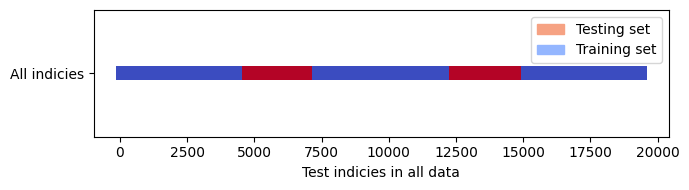

In [11]:
y = (source_data.date.isin(test_data.date).astype(int),)
fig, ax = plt.subplots(figsize=(7, 2))
cmap_cv = plt.cm.coolwarm
ax.scatter(
    source_data.index,
    [0.5] * len(source_data.index),
    c=y,
    marker="_",
    lw=10,
    cmap=cmap_cv,
)
ax.set(
    # ylim=[0.4, 0.75],
    yticks=[0.5],
    yticklabels=["All indicies"],
    xlabel="Test indicies in all data",
)
ax.legend(
    [Patch(color=cmap_cv(0.73)), Patch(color=cmap_cv(0.27))],
    ["Testing set", "Training set"],
)
plt.tight_layout()
plt.show()
# source_data.date.isin(test_data.date).astype(int)

### 1.1.5. Диаграммы размаха

Построим ящики с усами для признаков:

In [12]:
def features_boxplot(data, title):
    _, ax = plt.subplots(figsize=(10, 12))
    ax.set_title(title)
    ax2 = sns.boxplot(data=data)
    ax2.grid()
    ax2.set_xticklabels(ax2.get_xticklabels(), rotation=70, ha="right")
    plt.show()

Сначала посмотрим на общую картину всех входных признаков (доступных в тестовой выборке) в разбивке по тестовой/обучающей выборке и всем данным:

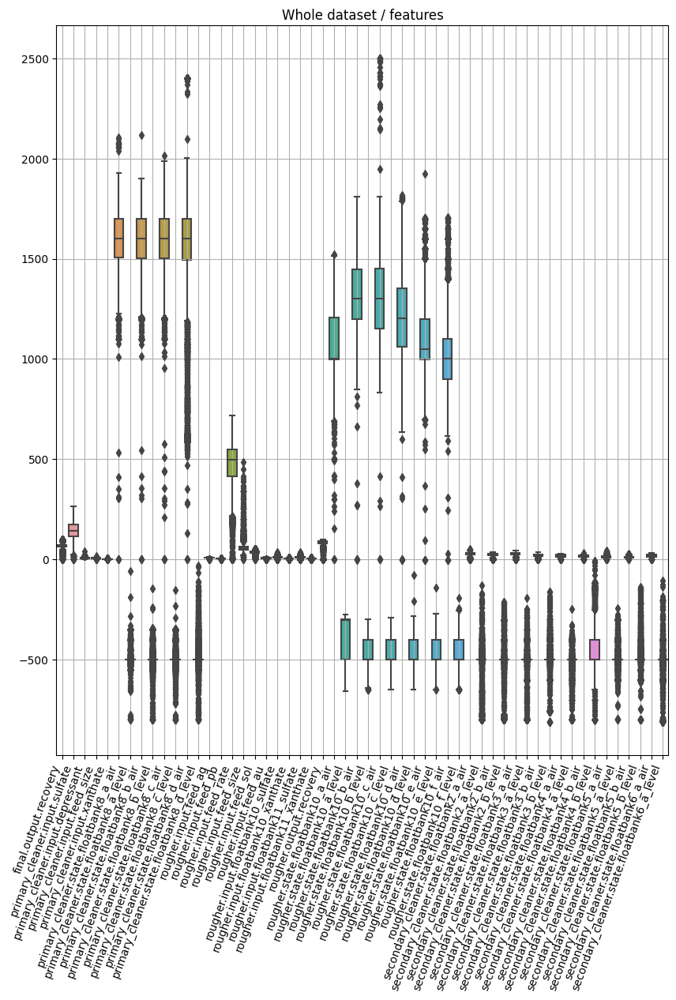

In [13]:
features_boxplot(source_data[input_state_cols_and_target], "Whole dataset / features")

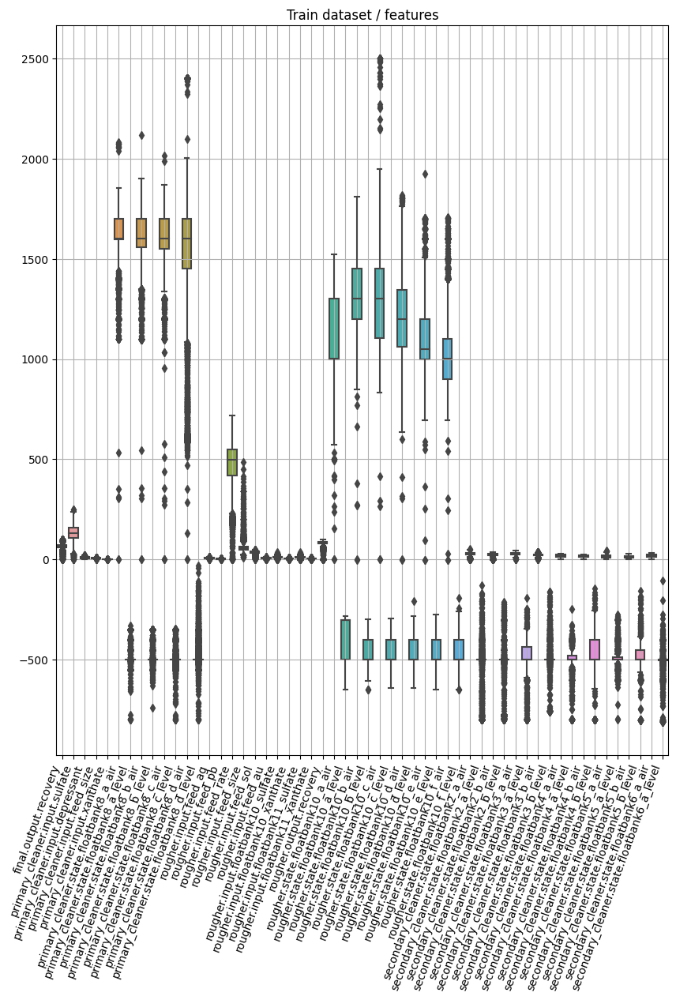

In [14]:
features_boxplot(train_data[input_state_cols_and_target], "Train dataset / features")

In [15]:
input_state_cols = input_state_cols_and_target.copy()
input_state_cols.remove("rougher.output.recovery")
input_state_cols.remove("final.output.recovery")

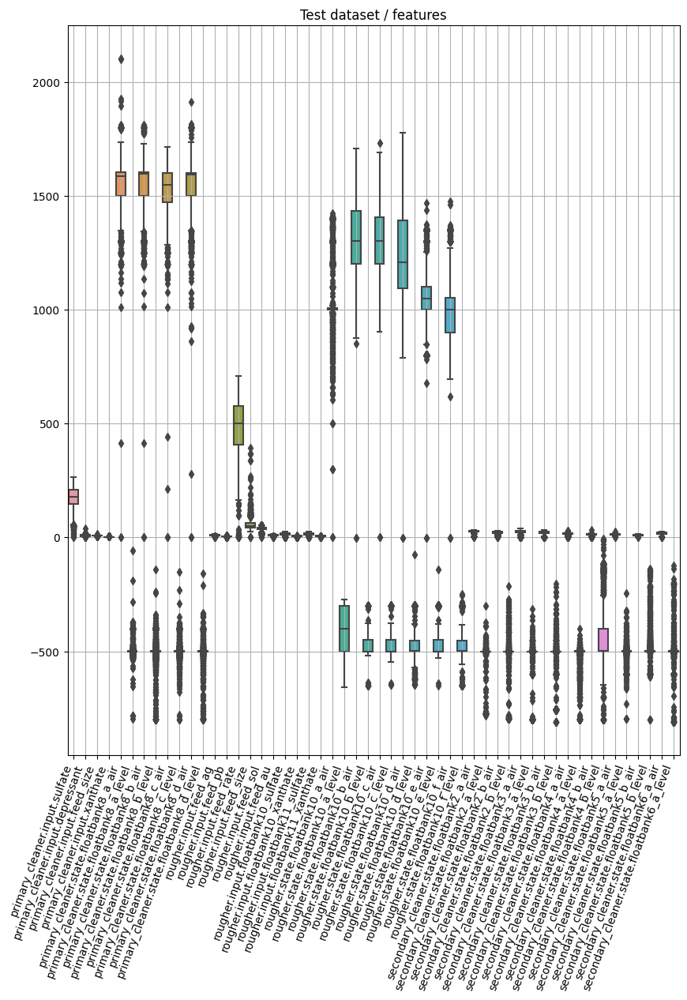

In [16]:
features_boxplot(test_data[input_state_cols], "Test dataset / features")

Видим похожие наборы диаграмм размаха для выборок и общего набора, но  отличия также есть, что может опять же говорить о неоптимальности разбиения на тестовую/обучающую выборки.

Далее для всего набора данных построим боксплоты для признаков со схожими амплитудами распределений, чтобы на графиках были видны подробности.

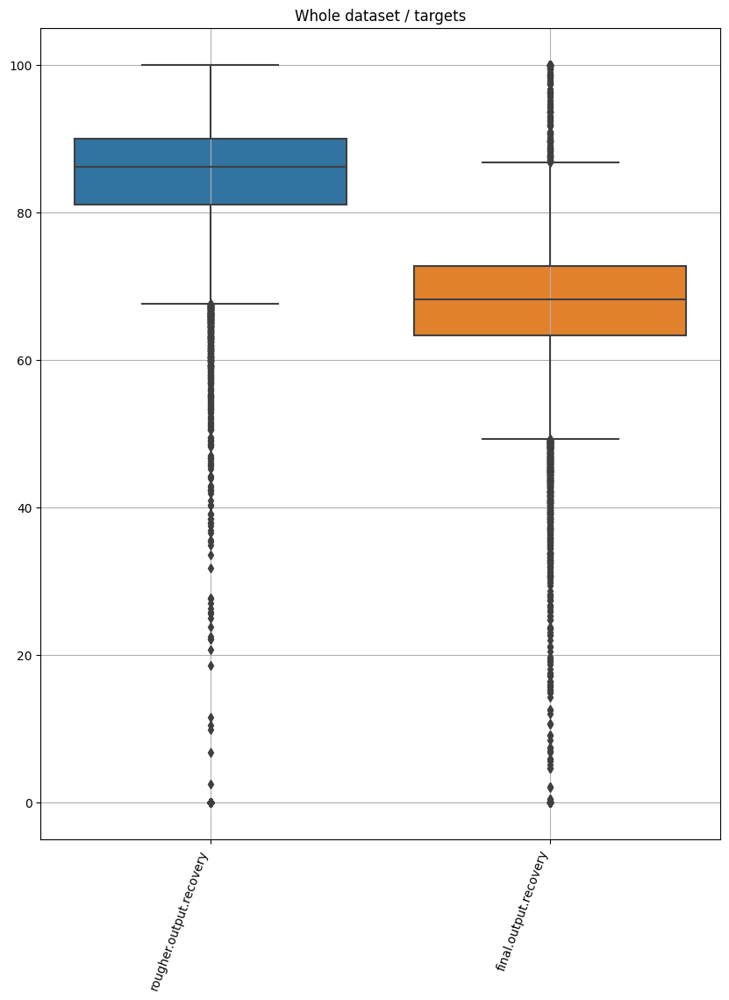

In [17]:
features_boxplot(
    source_data[["rougher.output.recovery", "final.output.recovery"]],
    "Whole dataset / targets",
)

In [18]:
level_columns = [
    col
    for col in train_data.columns
    if re.search(
        r".+\_level",
        col,
    )
]
level_columns

['primary_cleaner.state.floatbank8_a_level',
 'primary_cleaner.state.floatbank8_b_level',
 'primary_cleaner.state.floatbank8_c_level',
 'primary_cleaner.state.floatbank8_d_level',
 'rougher.state.floatbank10_a_level',
 'rougher.state.floatbank10_b_level',
 'rougher.state.floatbank10_c_level',
 'rougher.state.floatbank10_d_level',
 'rougher.state.floatbank10_e_level',
 'rougher.state.floatbank10_f_level',
 'secondary_cleaner.state.floatbank2_a_level',
 'secondary_cleaner.state.floatbank2_b_level',
 'secondary_cleaner.state.floatbank3_a_level',
 'secondary_cleaner.state.floatbank3_b_level',
 'secondary_cleaner.state.floatbank4_a_level',
 'secondary_cleaner.state.floatbank4_b_level',
 'secondary_cleaner.state.floatbank5_a_level',
 'secondary_cleaner.state.floatbank5_b_level',
 'secondary_cleaner.state.floatbank6_a_level']

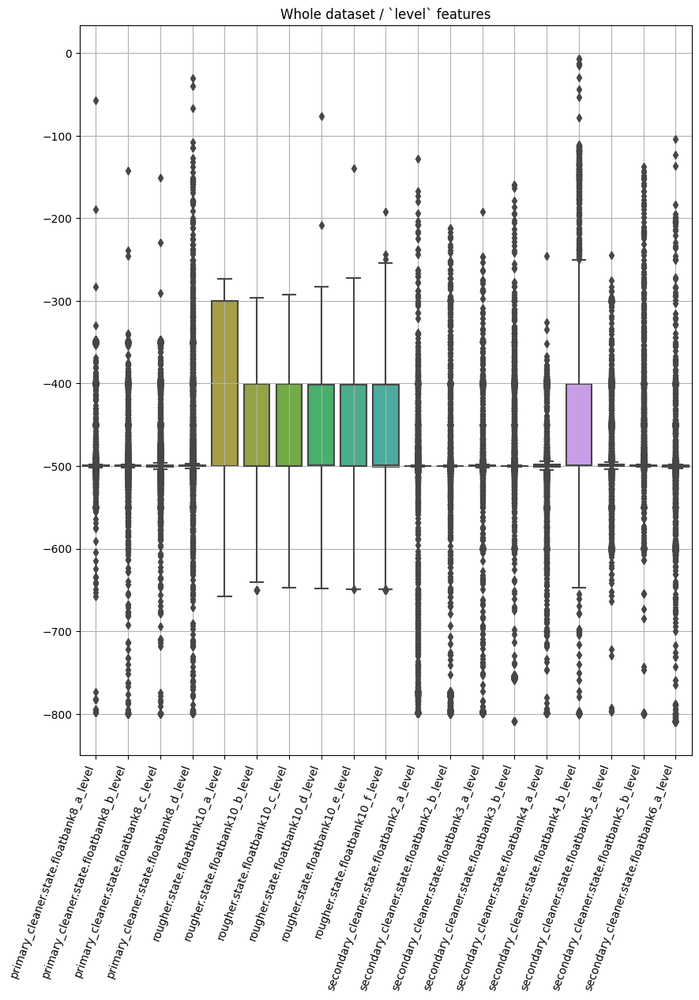

In [19]:
features_boxplot(source_data[level_columns], "Whole dataset / `level` features")

In [20]:
air_columns1 = [
    col
    for col in train_data.columns
    if re.search(
        r"(primary_cleaner|rougher).+\_air",
        col,
    )
]
air_columns1

['primary_cleaner.state.floatbank8_a_air',
 'primary_cleaner.state.floatbank8_b_air',
 'primary_cleaner.state.floatbank8_c_air',
 'primary_cleaner.state.floatbank8_d_air',
 'rougher.state.floatbank10_a_air',
 'rougher.state.floatbank10_b_air',
 'rougher.state.floatbank10_c_air',
 'rougher.state.floatbank10_d_air',
 'rougher.state.floatbank10_e_air',
 'rougher.state.floatbank10_f_air']

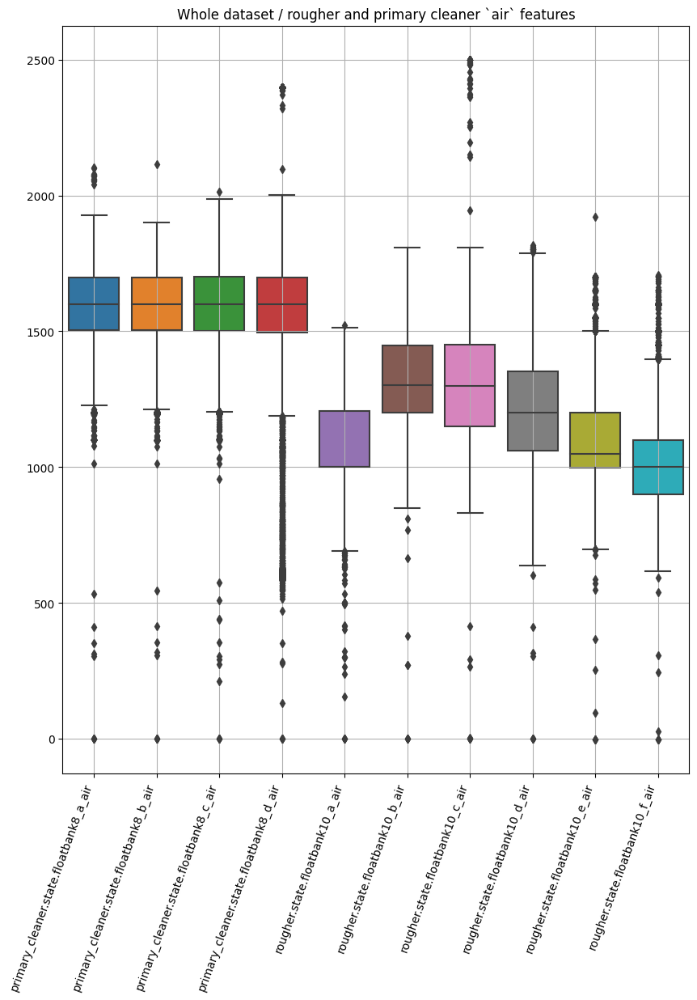

In [21]:
features_boxplot(
    source_data[air_columns1],
    "Whole dataset / rougher and primary cleaner `air` features",
)

In [22]:
air_columns2 = [
    col
    for col in train_data.columns
    if re.search(
        r"secondary_cleaner.+\_air",
        col,
    )
]
air_columns2

['secondary_cleaner.state.floatbank2_a_air',
 'secondary_cleaner.state.floatbank2_b_air',
 'secondary_cleaner.state.floatbank3_a_air',
 'secondary_cleaner.state.floatbank3_b_air',
 'secondary_cleaner.state.floatbank4_a_air',
 'secondary_cleaner.state.floatbank4_b_air',
 'secondary_cleaner.state.floatbank5_a_air',
 'secondary_cleaner.state.floatbank5_b_air',
 'secondary_cleaner.state.floatbank6_a_air']

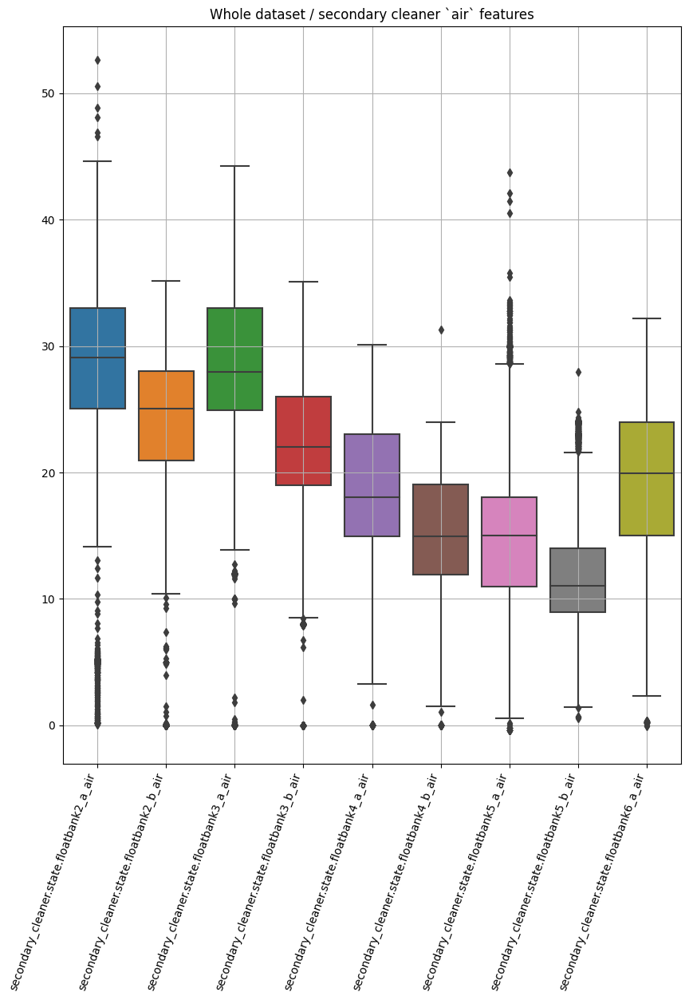

In [23]:
features_boxplot(
    source_data[air_columns2], "Whole dataset / secondary cleaner `air` features"
)

In [24]:
rougher_input_columns = [
    col
    for col in train_data.columns
    if re.search(
        r"^(?=rougher\.input\.)(?!.*(feed_rate|feed_size)).*",
        col,
    )
]
rougher_input_columns

['rougher.input.feed_ag',
 'rougher.input.feed_pb',
 'rougher.input.feed_sol',
 'rougher.input.feed_au',
 'rougher.input.floatbank10_sulfate',
 'rougher.input.floatbank10_xanthate',
 'rougher.input.floatbank11_sulfate',
 'rougher.input.floatbank11_xanthate']

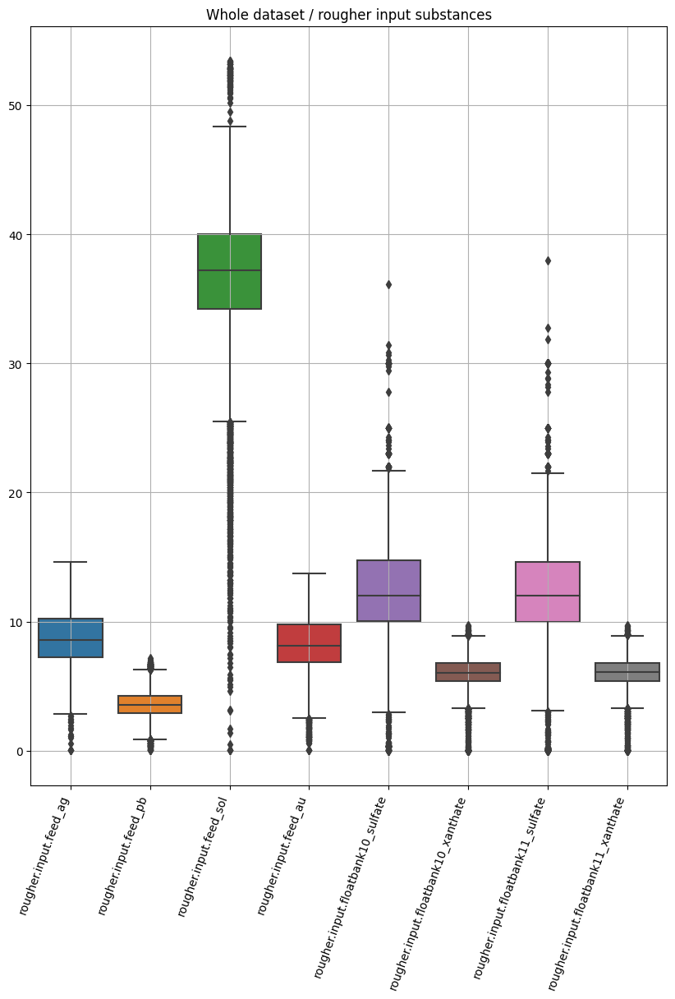

In [25]:
features_boxplot(
    source_data[rougher_input_columns],
    "Whole dataset / rougher input substances",
)

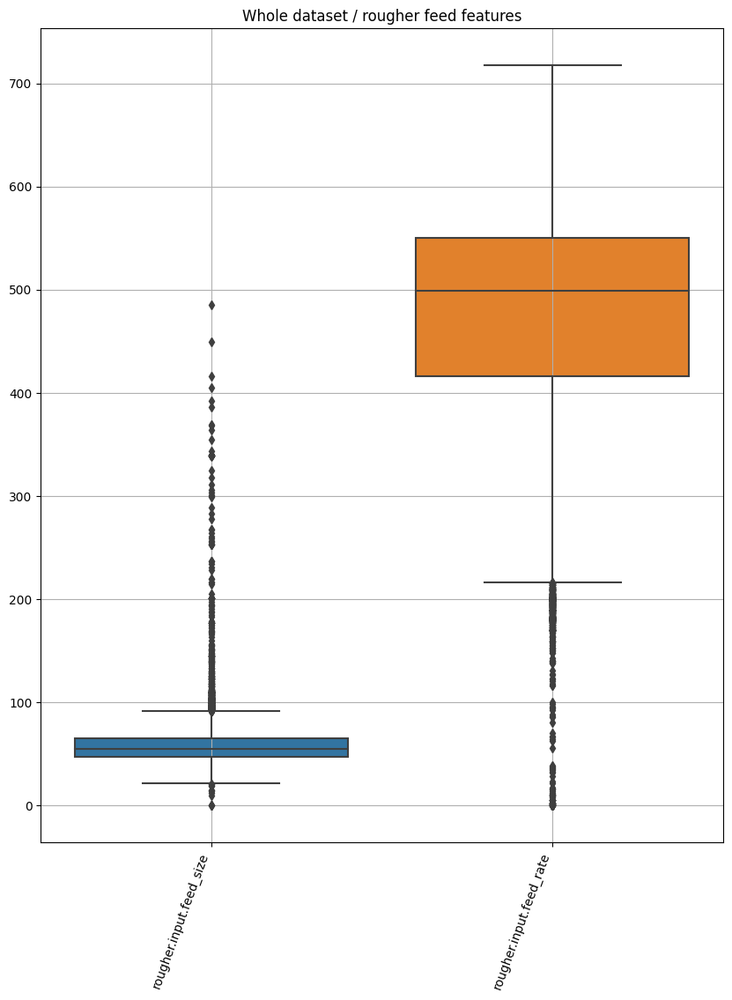

In [26]:
features_boxplot(
    source_data[["rougher.input.feed_size", "rougher.input.feed_rate"]],
    "Whole dataset / rougher feed features",
)

In [27]:
primary_cleaner_input_columns = [
    "primary_cleaner.input.depressant",
    "primary_cleaner.input.feed_size",
    "primary_cleaner.input.xanthate",
]
primary_cleaner_input_columns

['primary_cleaner.input.depressant',
 'primary_cleaner.input.feed_size',
 'primary_cleaner.input.xanthate']

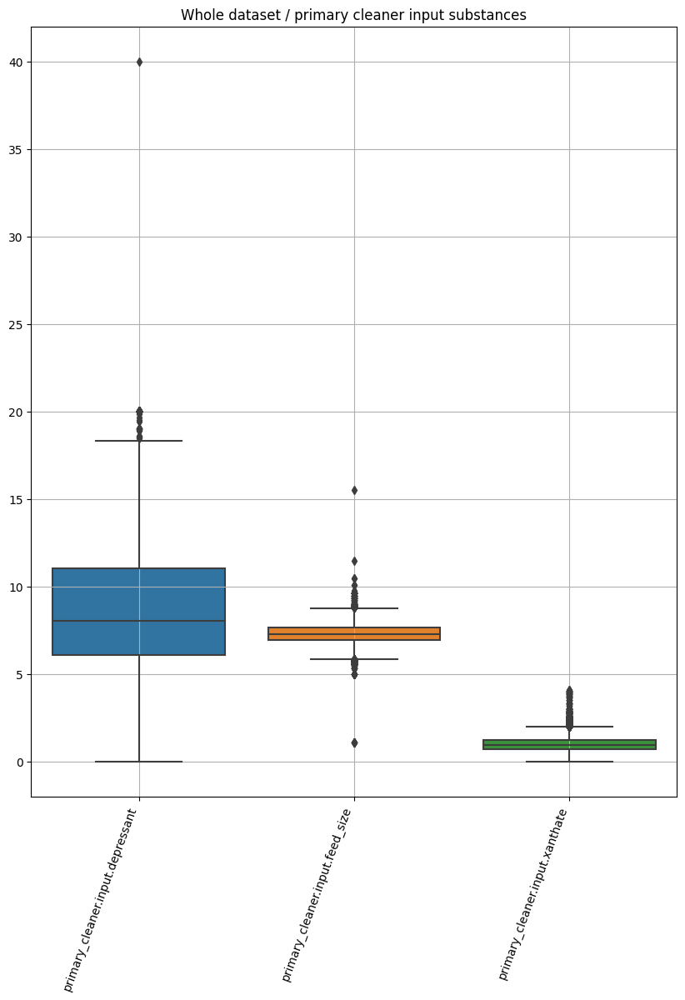

In [28]:
features_boxplot(
    source_data[primary_cleaner_input_columns],
    "Whole dataset / primary cleaner input substances",
)

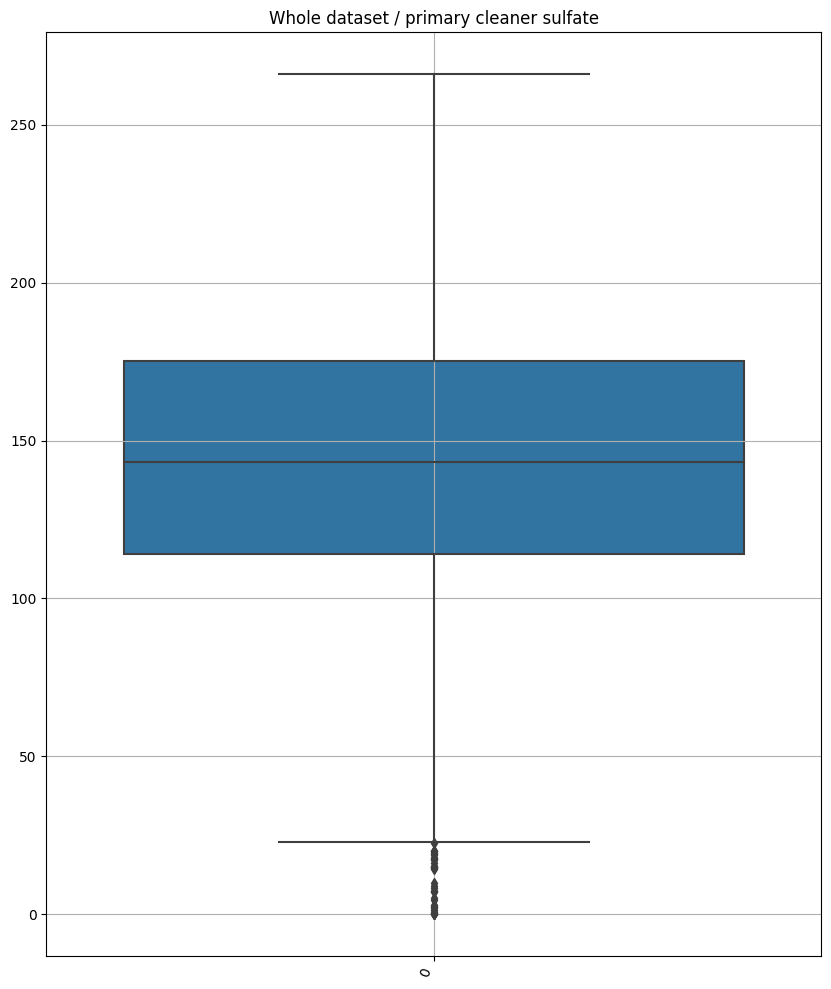

In [29]:
features_boxplot(
    source_data["primary_cleaner.input.sulfate"],
    "Whole dataset / primary cleaner sulfate",
)

<b>Вывод: </b> На диаграммах размаха для признаков доступных в тестовой выборке мы видим, что почти у всех признаков есть выбросы - что может повлиять на качество работы нашей модели. Причиной может служить уже названное непостоянное и неоптимальное физико-химическое состояние флотационной пульпы (смеси твёрдых частиц и жидкости), нестабильность в параметрах используемого оборудования, и даже человеческие ошибки при настройке этого оборудования (например подбор уровня ксантата или депрессанта). Следует попробовать обработать выбросы с помощью специальных scaler-ов (PowerTransformer, например), избавляться от них из-за их большого количества было бы не целесообразно.

### 1.1.6. EDA  с помощью pandas profiling

Выполним EDA c помощью pandas-profiling и sweetviz:

In [30]:
profile = ProfileReport(source_data, minimal=True)
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Нули в следующих признаках могут означать какие-то сбои в технологическом процессе (например выход из строя датчиков):
* rougher.output.concentrate_ag has 297 (2.1%) zeros
* rougher.output.concentrate_pb has 297 (2.1%) zeros
* rougher.output.concentrate_sol has 297 (2.1%) zeros
* rougher.output.concentrate_au has 297 (2.1%) zeros
* rougher.output.recovery has 297 (2.1%) zeros
* secondary_cleaner.output.tail_ag has 739 (5.2%) zeros
* secondary_cleaner.output.tail_pb has 739 (5.2%) zeros
* secondary_cleaner.output.tail_sol has 739 (5.2%) zeros
* secondary_cleaner.output.tail_au has 739 (5.2%) zeros

Разберемся с ними в разделе анализа концентрации веществ 2.3.

### 1.1.7. Признак date

В отчете выше видим, что признак date уникальный, то есть его можно использовать как идентификатор записи, например, чтобы восстановить целевые значения для тестовой выборки (в тестовой выборке нет значений recovery). Кроме того, убедимся, что масив данных отсортирован по колонке date - по числу несоответствий индексов при применении сортировки и без нее:

In [31]:
(source_data["date"].sort_values().index != source_data["date"].index).sum()

0

То есть, данные, предоставленные нам в файлах - это практически непрерывное детектирование параметров технологического процесса, если посмотреть на разницу по значениям datetime между соседними строками: 

<b>Вывод: </b> На диаграммах размаха для признаков доступных в тестовой выборке мы видим, что почти у всех признаков есть выбросы - что может повлиять на качество работы нашей модели. Следует попробовать обработать выбросы с помощью специальных scaler-ов (PowerTransformer, например).

In [32]:
pd.to_datetime(source_data["date"]).diff().value_counts()

0 days 01:00:00    19017
0 days 02:00:00      191
0 days 03:00:00       59
0 days 04:00:00       33
0 days 05:00:00       24
0 days 06:00:00       18
0 days 08:00:00       12
0 days 07:00:00       11
0 days 09:00:00        8
0 days 12:00:00        7
0 days 10:00:00        6
0 days 15:00:00        5
0 days 14:00:00        4
0 days 13:00:00        4
0 days 11:00:00        3
1 days 08:00:00        3
1 days 02:00:00        2
0 days 19:00:00        2
0 days 21:00:00        2
0 days 18:00:00        2
0 days 20:00:00        2
6 days 15:00:00        1
0 days 22:00:00        1
6 days 19:00:00        1
3 days 07:00:00        1
1 days 10:00:00        1
5 days 13:00:00        1
1 days 14:00:00        1
2 days 12:00:00        1
5 days 04:00:00        1
8 days 03:00:00        1
2 days 00:00:00        1
1 days 03:00:00        1
4 days 03:00:00        1
3 days 06:00:00        1
1 days 04:00:00        1
1 days 23:00:00        1
3 days 13:00:00        1
0 days 06:59:59        1
5 days 14:00:00        1


Разница между начальной датой и конечной в днях:

In [33]:
human_format(
    (
        (
            pd.to_datetime(source_data["date"].iloc[-1:]).values
            - pd.to_datetime(source_data["date"].iloc[:1]).values
        )
        / np.timedelta64(1, "D")
    )[0]
)

'946'


Это опять приводит нас к тому, что положение индексов предоставленной тестовой выборки неоптимально относительно всего датасета - параметры процесса могу меняться с течением времени. Посмотрим также есть ли корреляция с временными данными выделив из date тe части времени которые повторяются из года в год (и могут быть извлечены из будущих данных) и могут влиять на технологический процесс день месяца, день года, день недели: 

In [34]:
source_data["date"] = pd.to_datetime(source_data["date"])
source_data["date_weekday"] = source_data["date"].dt.weekday
source_data["date_monthday"] = source_data["date"].dt.day
source_data["date_yearday"] = source_data["date"].dt.dayofyear
source_data["date_hour"] = source_data["date"].dt.hour

In [35]:
train_data["date"] = pd.to_datetime(source_data["date"])
train_data["date_weekday"] = source_data["date"].dt.weekday
train_data["date_monthday"] = source_data["date"].dt.day
train_data["date_yearday"] = source_data["date"].dt.dayofyear
train_data["date_hour"] = source_data["date"].dt.hour

In [36]:
input_state_cols_and_target.extend(
    ["date_weekday", "date_monthday", "date_yearday", "date_hour"]
)

Для примера покажем погодовой график зависимости эффективности обогащения чернового концентрата от дня месяца:

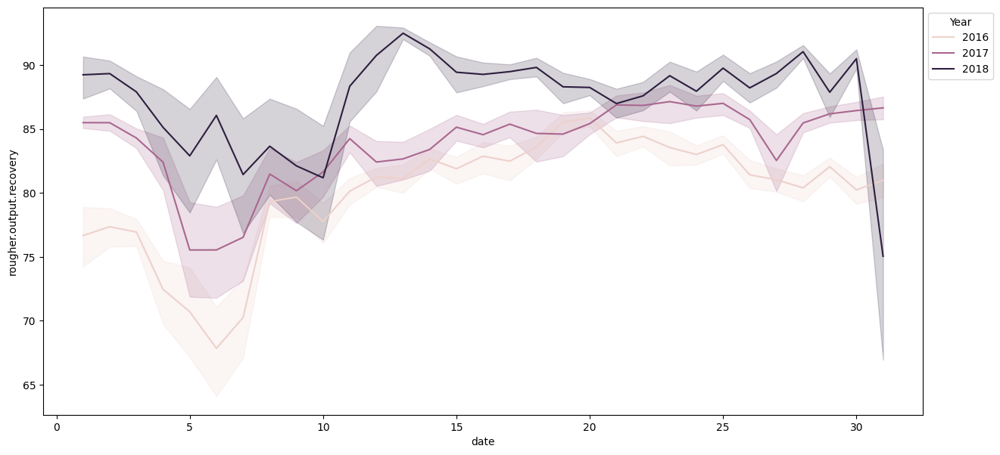

In [37]:
fig, ax = plt.subplots(figsize=(15, 7))

sns.lineplot(
    x=source_data.date.dt.day,
    y=source_data["rougher.output.recovery"],
    hue=source_data.date.dt.year,
    ax=ax,
)
ax.legend(title="Year", bbox_to_anchor=(1, 1), loc="upper left")
plt.show()

### 1.1.8. Пропуски в данных

Посмотрим на пропуски в данных:

In [38]:
with pd.option_context("display.max_rows", None, "display.width", None):
    display(
        source_data.isna()
        .sum()[source_data.isna().sum() != 0]
        .sort_values(ascending=False)
    )

secondary_cleaner.output.tail_sol                     1748
rougher.input.floatbank11_xanthate                     453
rougher.state.floatbank10_e_air                        436
primary_cleaner.output.concentrate_sol                 370
secondary_cleaner.state.floatbank2_a_air               220
final.output.concentrate_sol                           211
rougher.input.feed_size                                145
primary_cleaner.output.concentrate_pb                  116
primary_cleaner.input.xanthate                         104
final.output.tail_pb                                   101
rougher.input.feed_pb                                  100
rougher.input.feed_sol                                  99
primary_cleaner.output.tail_sol                         62
rougher.input.floatbank11_sulfate                       44
primary_cleaner.input.depressant                        37
rougher.input.floatbank10_sulfate                       34
primary_cleaner.input.sulfate                           

Отдельно для train_data по входным данным для этапа грубой очистки:

In [39]:
rougher_input_state_cols_and_target = [
    col
    for col in train_data.columns
    if re.search(
        r"date|rougher\.input.+|rougher\.state.+|rougher\.output\.recovery", col
    )
]

In [40]:
with pd.option_context("display.max_rows", None, "display.width", None):
    display(
        train_data[rougher_input_state_cols_and_target]
        .isna()
        .sum()[train_data[rougher_input_state_cols_and_target].isna().sum() != 0]
        .sort_values(ascending=False)
    )

rougher.state.floatbank10_e_air       436
rougher.input.floatbank11_xanthate    428
rougher.input.feed_size               144
rougher.input.feed_pb                 100
rougher.input.feed_sol                 78
rougher.input.floatbank11_sulfate      36
rougher.input.floatbank10_sulfate      29
rougher.input.feed_rate                 8
rougher.input.floatbank10_xanthate      8
rougher.state.floatbank10_a_air         1
rougher.state.floatbank10_a_level       1
rougher.state.floatbank10_b_air         1
rougher.state.floatbank10_b_level       1
rougher.state.floatbank10_c_air         1
rougher.state.floatbank10_c_level       1
dtype: int64

Отдельно по входным данным для всех этапов:

In [41]:
with pd.option_context("display.max_rows", None, "display.width", None):
    display(
        train_data[test_data_original.columns.values]
        .isna()
        .sum()[train_data[test_data_original.columns.values].isna().sum() != 0]
        .sort_values(ascending=False)
    )

rougher.state.floatbank10_e_air               436
rougher.input.floatbank11_xanthate            428
secondary_cleaner.state.floatbank2_a_air      217
rougher.input.feed_size                       144
rougher.input.feed_pb                         100
primary_cleaner.input.xanthate                100
rougher.input.feed_sol                         78
rougher.input.floatbank11_sulfate              36
primary_cleaner.input.depressant               32
rougher.input.floatbank10_sulfate              29
secondary_cleaner.state.floatbank2_b_air       21
primary_cleaner.input.sulfate                  20
rougher.input.feed_rate                         8
rougher.input.floatbank10_xanthate              8
secondary_cleaner.state.floatbank4_a_air        6
primary_cleaner.state.floatbank8_a_air          4
primary_cleaner.state.floatbank8_b_air          4
secondary_cleaner.state.floatbank3_a_air        4
primary_cleaner.state.floatbank8_d_air          3
primary_cleaner.state.floatbank8_c_air          2


Так как очень много строк с пропусками, а процесс разделен на этапы со своим набором входных параметров, то сразу все пропуски удалять/обрабатывать не будем - обработаем их при работе с конкретным этапом флотации/очистки (возможно, используем для этого Imputer). 

### 1.1.9. EDA  с помощью sweetviz

С помощью sweetviz можно сравнивать тестовый и обучающий набор данных. Для этого извлечем все недостающие данные из source_date по значению столбца date в test_date. Но прежде сделаем функцию для укорачивания названий столбцов чтобы они помещались в интерфейс sweetviz.

In [42]:
# aux func to cut column names to fit the graphs (especially correlation matrix)
def cut_columns_names(columns, cut_to_eleven_chars=True):

    columns = [
        "".join(
            name[0]
            if i < 2
            else "." + name.replace("floatbank", "fb").replace("concentrate", "cntr")
            for i, name in enumerate(col.split("."))
        )
        if col.find(".") > -1
        else col
        for col in columns
    ]
    return (
        [col[:11] if len(col) > 11 else col for col in columns]
        if cut_to_eleven_chars
        else columns
    )

Извлечем полные тестовые данные из исходных:

In [43]:
test_data_from_source = source_data[source_data.date.isin(test_data.date)]

In [44]:
test_data_from_source_4_sv = test_data_from_source.copy()
test_data_from_source_4_sv.columns = cut_columns_names(
    test_data_from_source_4_sv.columns
)

Получились такие столбцы (первые две буквы - это первые буквы названия этапа и типа парметра, а название параметра сжато до 11 символов):

test_data_from_source_4_sv.columns

In [45]:
train_data_4_sv = source_data[source_data.date.isin(train_data.date)]
train_data_4_sv.columns = cut_columns_names(train_data_4_sv.columns)

In [46]:
train_test_full_report = sweetviz.compare(
    [train_data_4_sv.drop(columns=['date']), "Train"],
    [test_data_from_source_4_sv.drop(columns=['date']), "Test"],
    "fo.recovery",
)

                                             | | [  0%]   00:00 


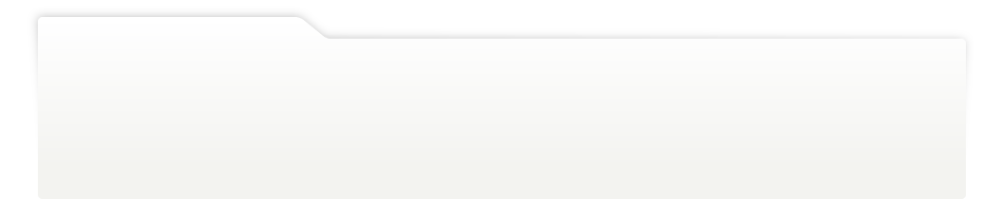
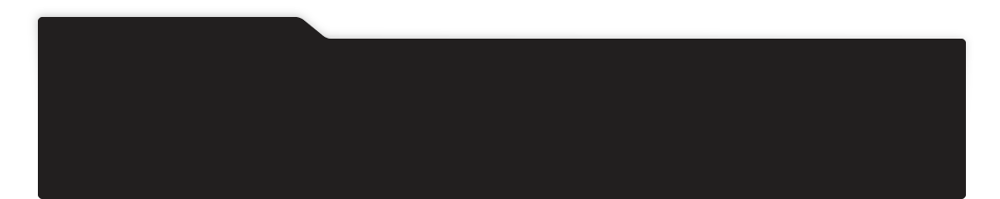
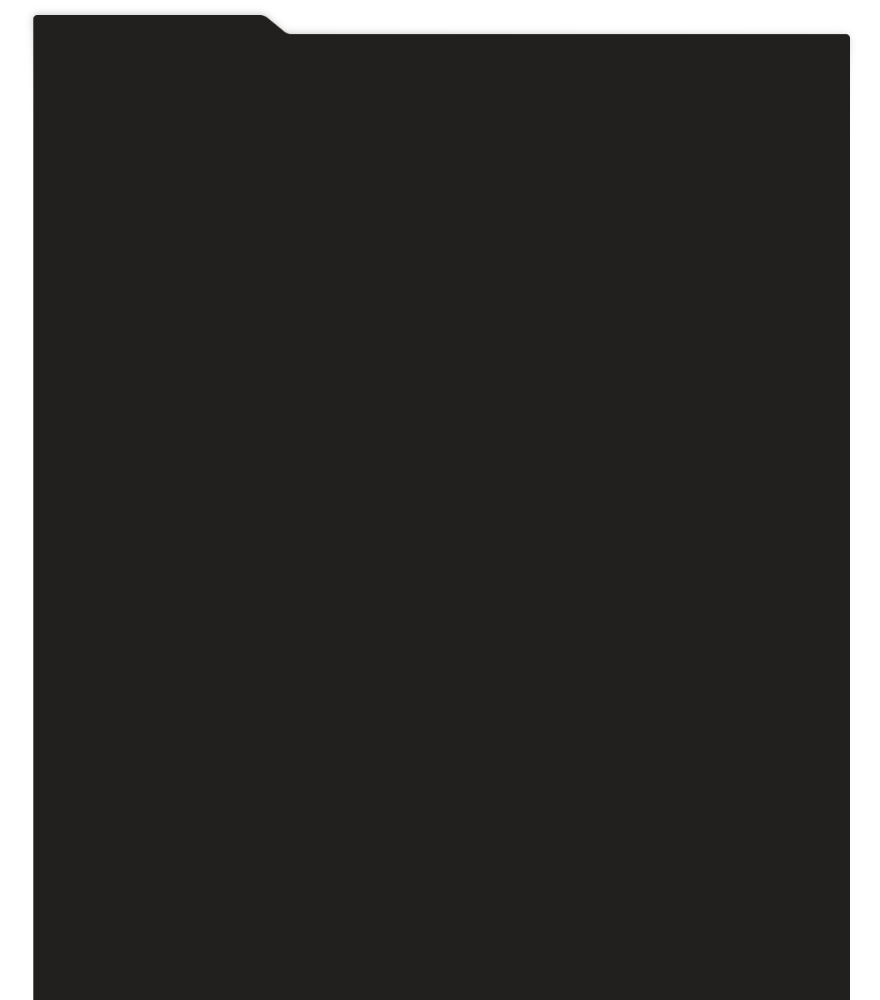
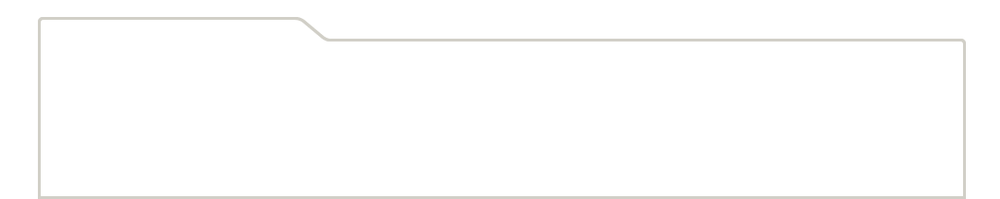
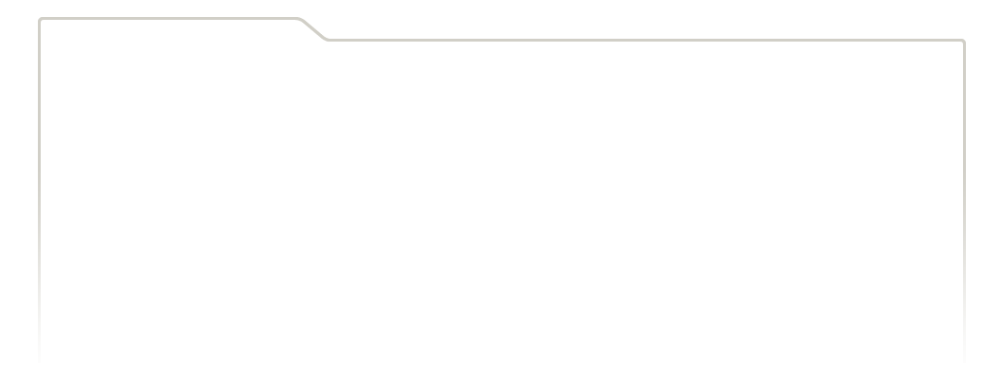
...
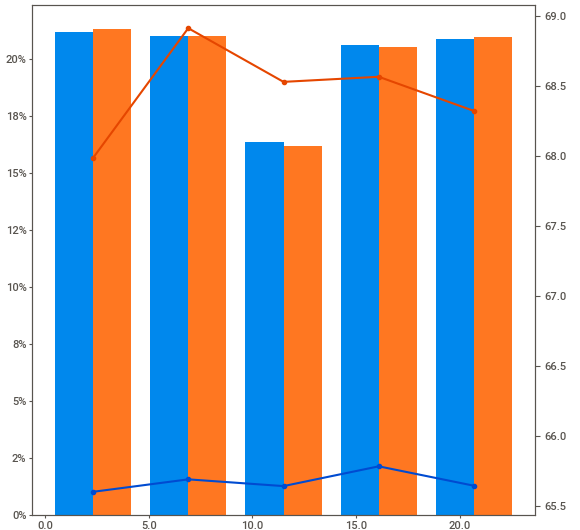
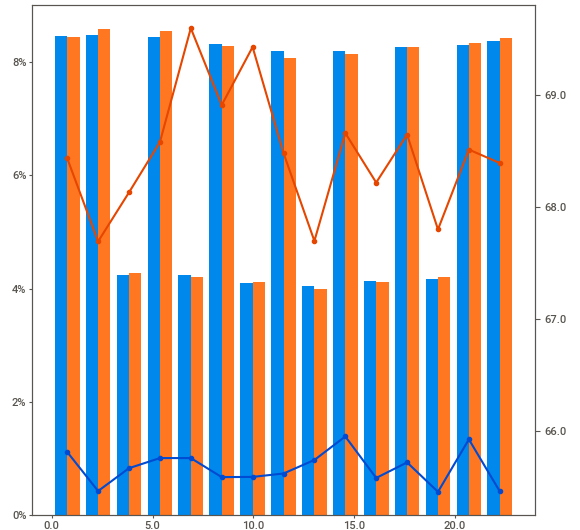
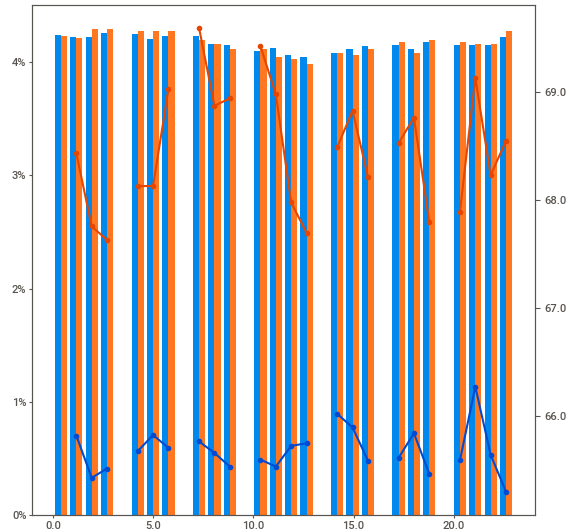
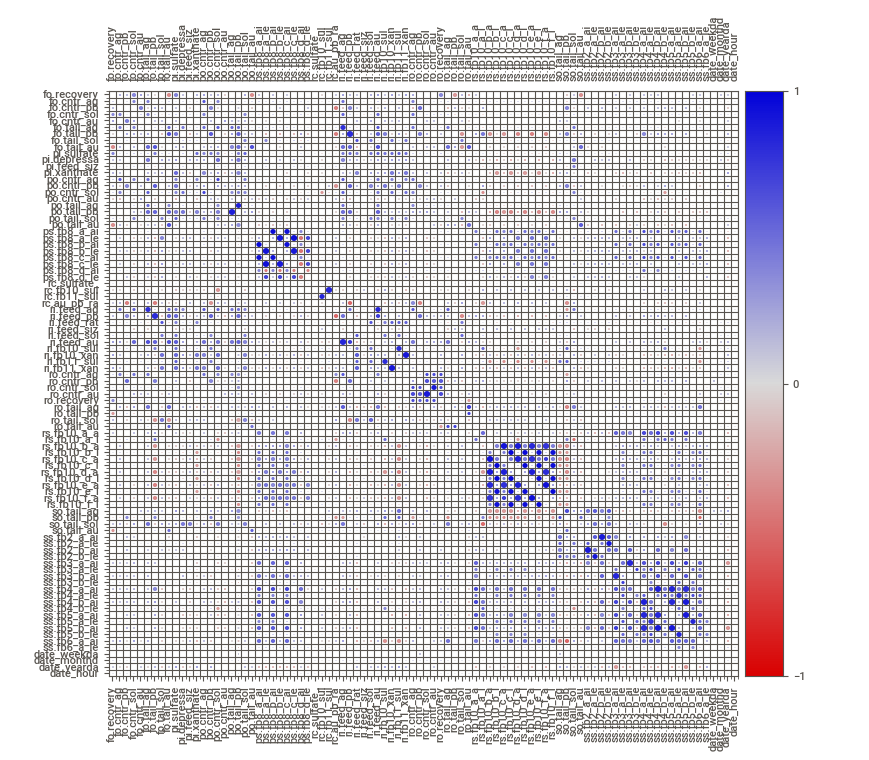
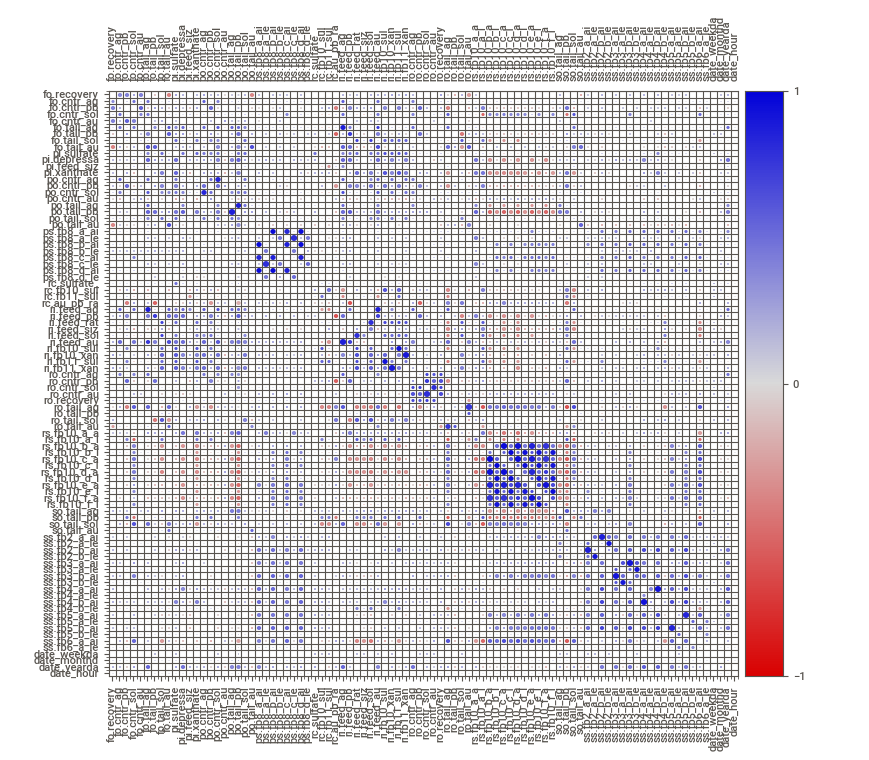

In [47]:
# train_test_full_report.show_html("Train and test full - final recovery.html")
train_test_full_report.show_notebook()

<b>Вывод 1: </b> В отчете видим достаточно много различий в распределениях признаков. Например, в наиболее влияющем на значения recovery - сульфате на входе в первый очиститель (primary_cleaner.input.sulfate - pi.sulfate) видно сильное смещение пиков test-гистограммы относительно train-гистограммы.

___

Отдельно посмотрим на сравнительный отчет по входным (input/state) и целевым признакам для обучающей и тестовой выборок, target - rougher.output.recovery:

In [48]:
train_data_4_sv_input = train_data_4_sv[
    cut_columns_names(rougher_input_state_cols_and_target)
]
test_data_from_source_4_sv_input = test_data_from_source_4_sv[
    cut_columns_names(rougher_input_state_cols_and_target)
]

In [49]:
train_test_input_report_rougher = sweetviz.compare(
    [train_data_4_sv_input.drop(columns=['date']), "Train"],
    [test_data_from_source_4_sv_input.drop(columns=['date']), "Test"],
    "ro.recovery",
)

                                             | | [  0%]   00:00 


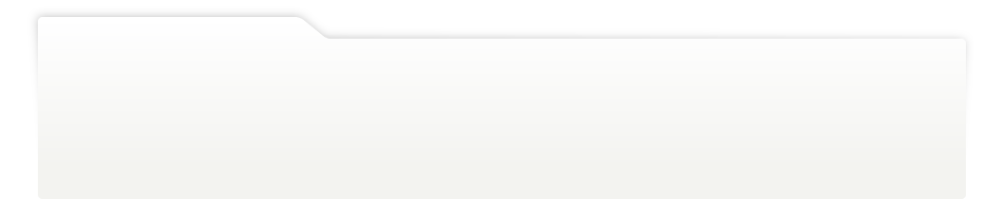
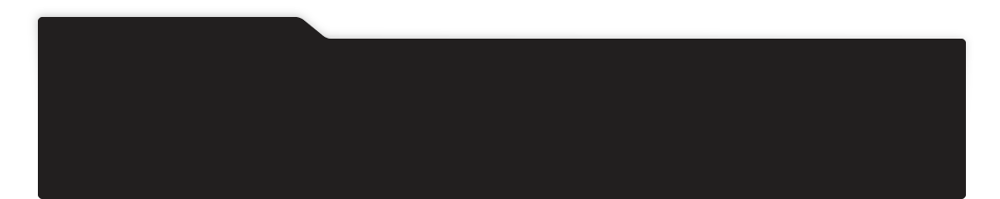
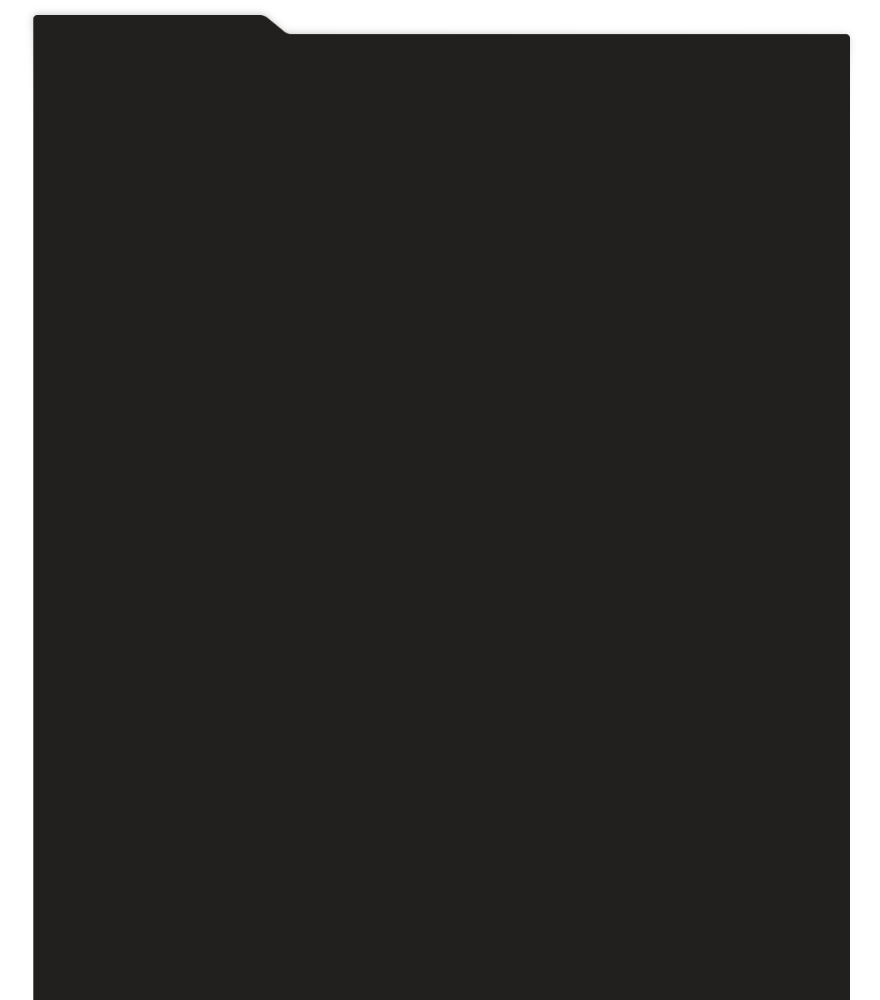
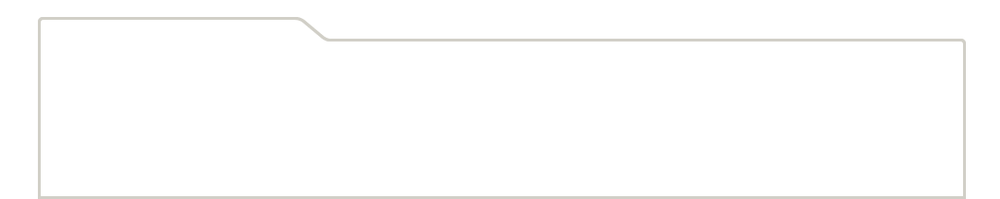
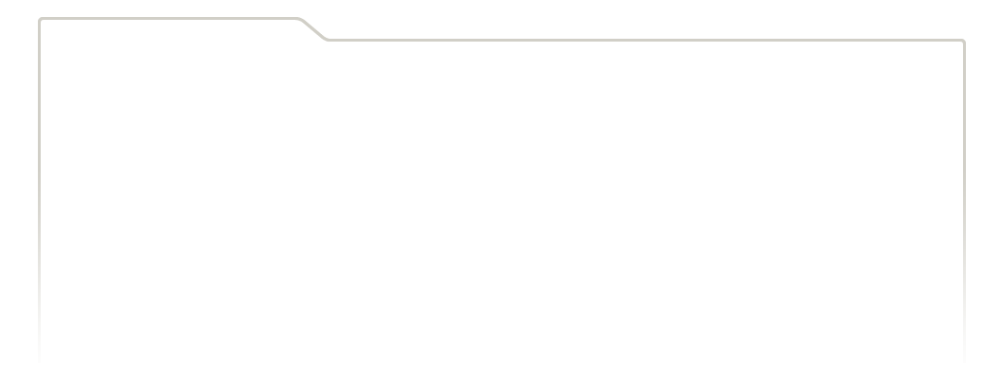
...
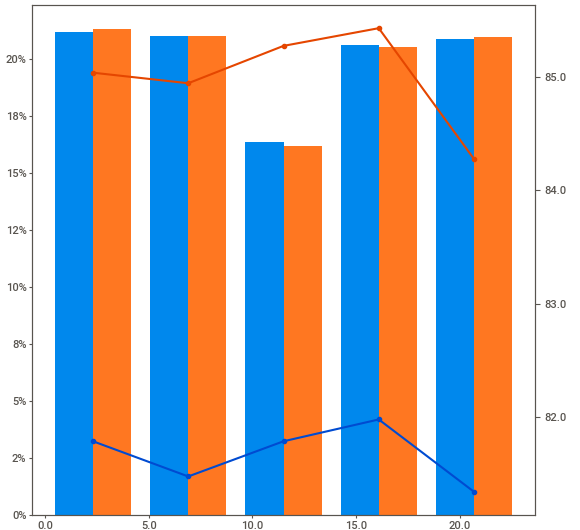
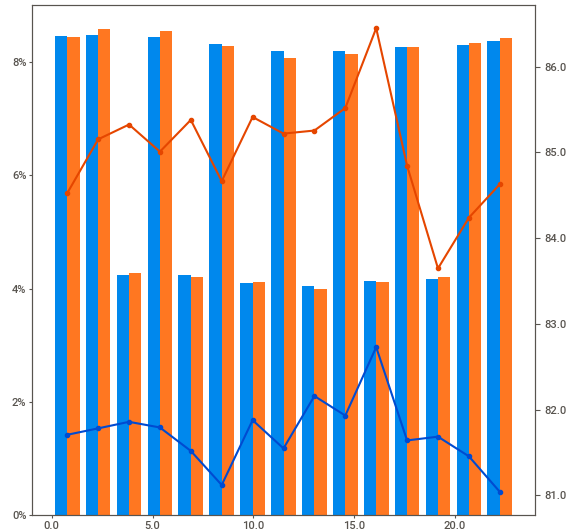
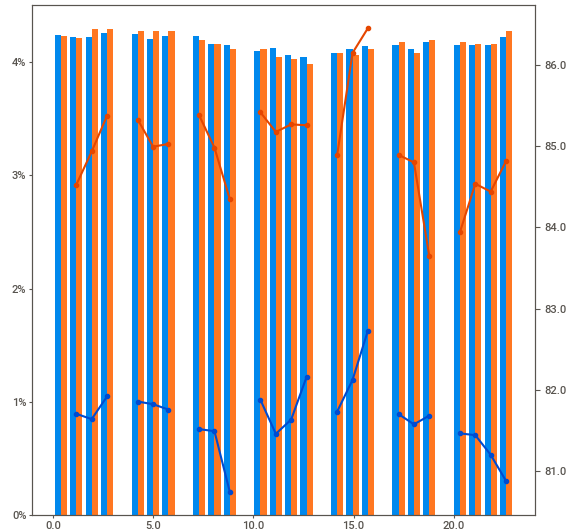
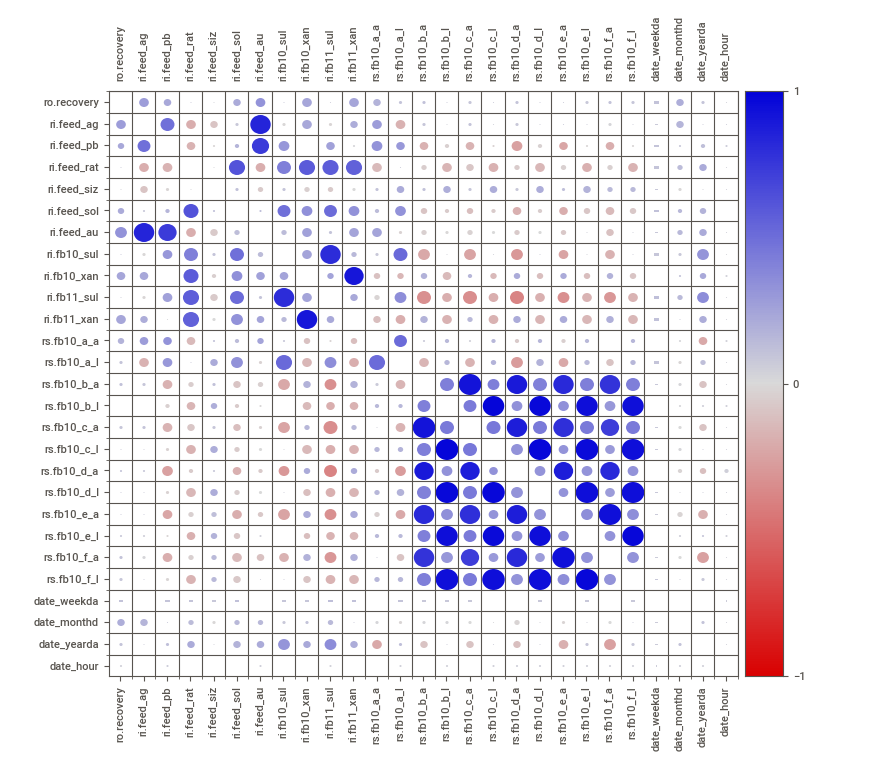
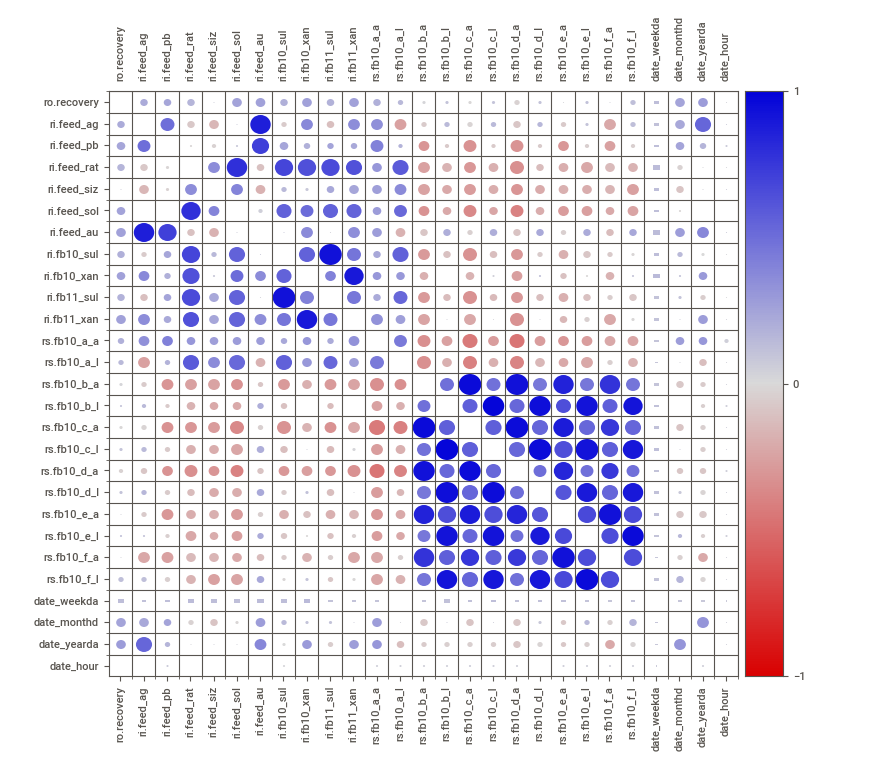

In [50]:
# train_test_input_report_rougher.show_html("Train and test - rougher recovery.html")
train_test_input_report_rougher.show_notebook()

<b>Вывод 2: </b> В отчете по этапу флотации опять видим достаточно много различий в распределениях признаков. Например, во влияющих на значения recovery для rougher - концентрациях веществ на входе ri.feed_ag, ri.feed_pb, ri.feed_au видны смещения пиков test-гистограммы относительно train-гистограммы.

### 1.1.10. Корреляционные матрицы

Построим корреляционные матрицы для отображения числовых значений корреляции Пирсона на тепловых картах:

In [51]:
corr = source_data[
    [col for col in source_data.columns if re.search(r"date.*|rougher\..+", col)]
].corr()

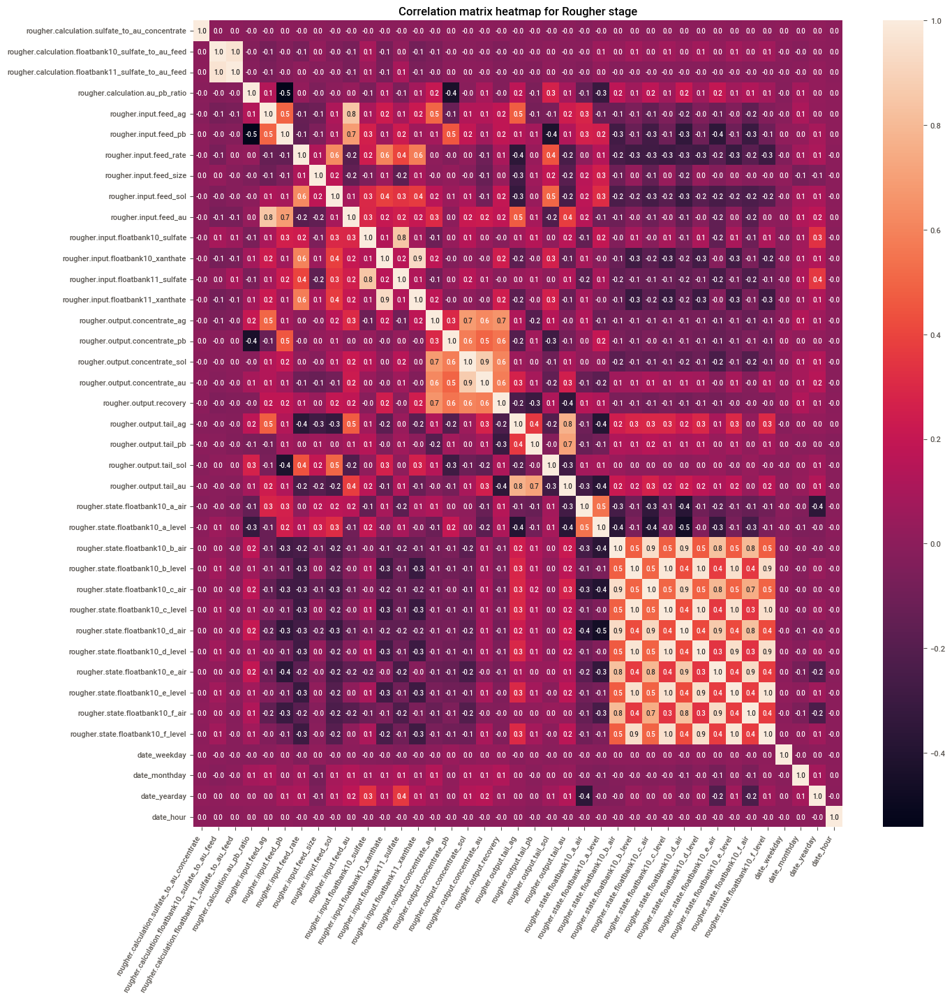

In [52]:
_, ax = plt.subplots(figsize=(15, 15))
fig = sns.heatmap(
    corr,
    xticklabels=corr.columns.values,
    yticklabels=corr.columns.values,
    annot=True,
    annot_kws={"fontsize": 7},
    fmt=".1f",
    ax=ax,
)

fig.set_title(f"Correlation matrix heatmap for Rougher stage")
plt.xticks(rotation=60, ha="right")
plt.show()

In [53]:
corr = source_data[
    [
        col
        for col in source_data.columns
        if re.search(
            r"rougher\.input\..+|rougher\.state\..+|primary_cleaner\.input\..+|primary_cleaner\.state\..+|secondary_cleaner\.input\..+|secondary_cleaner\.state\..+|final\.output\.recovery",
            col,
        )
    ]
].corr()

In [54]:
corr.columns = cut_columns_names(corr.columns, False)
corr.index = cut_columns_names(corr.index, False)

In [55]:
corr.columns

Index(['fo.recovery', 'pi.sulfate', 'pi.depressant', 'pi.feed_size',
       'pi.xanthate', 'ps.fb8_a_air', 'ps.fb8_a_level', 'ps.fb8_b_air',
       'ps.fb8_b_level', 'ps.fb8_c_air', 'ps.fb8_c_level', 'ps.fb8_d_air',
       'ps.fb8_d_level', 'ri.feed_ag', 'ri.feed_pb', 'ri.feed_rate',
       'ri.feed_size', 'ri.feed_sol', 'ri.feed_au', 'ri.fb10_sulfate',
       'ri.fb10_xanthate', 'ri.fb11_sulfate', 'ri.fb11_xanthate',
       'rs.fb10_a_air', 'rs.fb10_a_level', 'rs.fb10_b_air', 'rs.fb10_b_level',
       'rs.fb10_c_air', 'rs.fb10_c_level', 'rs.fb10_d_air', 'rs.fb10_d_level',
       'rs.fb10_e_air', 'rs.fb10_e_level', 'rs.fb10_f_air', 'rs.fb10_f_level',
       'ss.fb2_a_air', 'ss.fb2_a_level', 'ss.fb2_b_air', 'ss.fb2_b_level',
       'ss.fb3_a_air', 'ss.fb3_a_level', 'ss.fb3_b_air', 'ss.fb3_b_level',
       'ss.fb4_a_air', 'ss.fb4_a_level', 'ss.fb4_b_air', 'ss.fb4_b_level',
       'ss.fb5_a_air', 'ss.fb5_a_level', 'ss.fb5_b_air', 'ss.fb5_b_level',
       'ss.fb6_a_air', 'ss.fb6_a_level'],

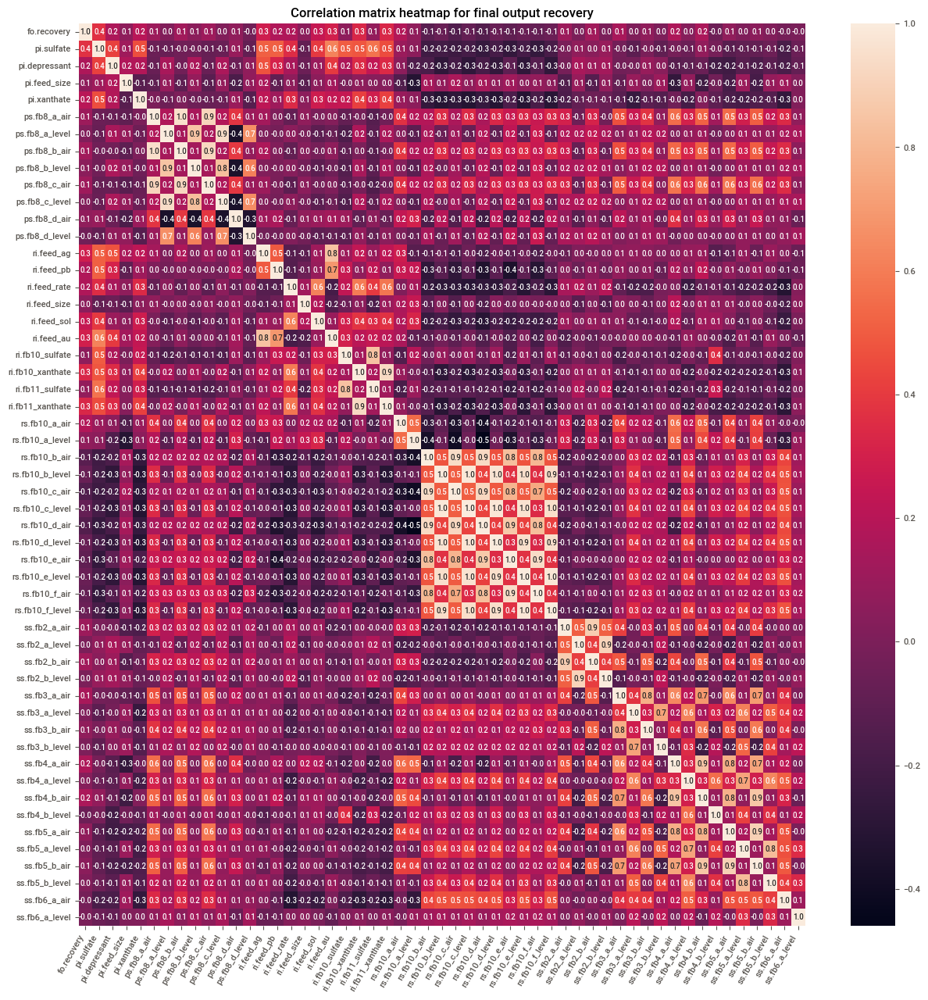

In [56]:
_, ax = plt.subplots(figsize=(15, 15))
fig = sns.heatmap(
    corr,
    xticklabels=corr.columns.values,
    yticklabels=corr.columns.values,
    annot=True,
    annot_kws={"fontsize": 7},
    fmt=".1f",
    ax=ax,
)

fig.set_title(f"Correlation matrix heatmap for final output recovery")
plt.xticks(rotation=60, ha="right")
plt.show()

Здесь мы видим большое число связей между признаками, где-то близких к линейным, характеризующих особенности технологического процесса. На картах также видны выделяющиеся прямоугольники с повторяющимся узором - характеризующие связи одного типа переменных с другим типом (например, для признаков с *floatbank* в названии с первого очистителя с аналогичными признаками на втором очистителе, или уже более слабые связи с начальным этапом грубой очистки)

### 1.1.11. Эффективность обогащения

Проверим, что эффективность обогащения рассчитана правильно:

In [57]:
rougher_recovery_recalculated = (
    (
        train_data["rougher.output.concentrate_au"]
        * (train_data["rougher.input.feed_au"] - train_data["rougher.output.tail_au"])
    )
    / (
        train_data["rougher.input.feed_au"]
        * (
            train_data["rougher.output.concentrate_au"]
            - train_data["rougher.output.tail_au"]
        )
    )
    * 100
)

Посчитаем MAE между нашими расчетами и данными в таблице:

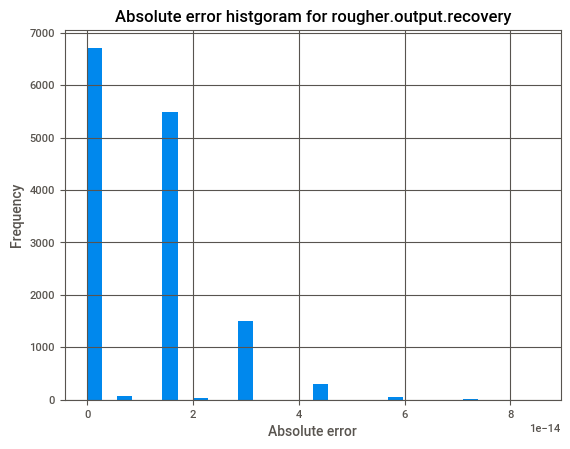

Mean Absolute Error (MAE) for rougher.output.recovery: 9.73512347450521e-15


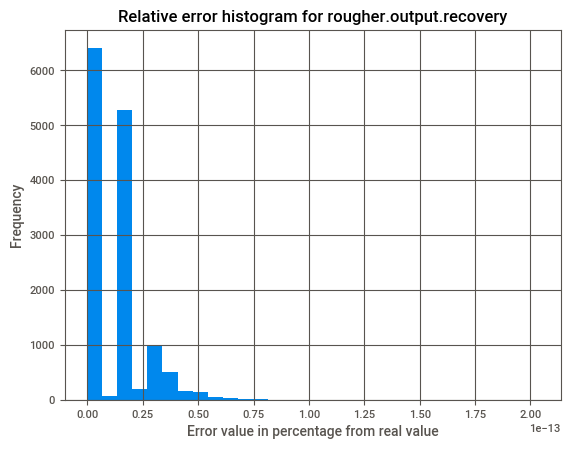

In [58]:
mae_rough_recovery = (
    rougher_recovery_recalculated - train_data["rougher.output.recovery"]
).abs()
ax = mae_rough_recovery.hist(bins=30)
plt.title("Absolute error histgoram for rougher.output.recovery")
ax.set_ylabel("Frequency")
ax.set_xlabel("Absolute error")


# train_data["rougher.output.recovery"].hist(bins=30)
plt.show()
print(
    "Mean Absolute Error (MAE) for rougher.output.recovery:", mae_rough_recovery.mean()
)

ax = ((mae_rough_recovery / train_data["rougher.output.recovery"]) * 100).hist(bins=30)
plt.title("Relative error histogram for rougher.output.recovery")
ax.set_ylabel("Frequency")
ax.set_xlabel("Error value in percentage from real value")
plt.show()

<b>Вывод: </b>Здесь мы видим, что ошибка составляет менее $1*10^{-13}$ процента от значений признака, что похоже на погрешность, возникающую при выполнении операций над числами с плавающей запятой.

## 1.2. Анализ данных

### 1.2.1. Концентрация металлов на разных этапах очистки

Выведем список всех признаков, характеризующих концентрации металлов на разных этапах технологического процесса: 

In [59]:
[col for col in source_data.columns if col.split("_")[-1:][0] in ["pb", "au", "ag"]]

# "final.output.concentrate_pb".split("_")[-1:][0] in ["pb", "au"]

['final.output.concentrate_ag',
 'final.output.concentrate_pb',
 'final.output.concentrate_au',
 'final.output.tail_ag',
 'final.output.tail_pb',
 'final.output.tail_au',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_au',
 'primary_cleaner.output.tail_ag',
 'primary_cleaner.output.tail_pb',
 'primary_cleaner.output.tail_au',
 'rougher.input.feed_ag',
 'rougher.input.feed_pb',
 'rougher.input.feed_au',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_au',
 'rougher.output.tail_ag',
 'rougher.output.tail_pb',
 'rougher.output.tail_au',
 'secondary_cleaner.output.tail_ag',
 'secondary_cleaner.output.tail_pb',
 'secondary_cleaner.output.tail_au']

Напишем специальную функцию для построения графиков концентраций металов:

In [60]:
def metal_concentration_graph(
    title, data, parameter_types_list, stages_order_list=None, axes=None
):
    source_data = data.copy()

    # renaming to multistring features
    source_data.columns = [col.replace(".", ".\n") for col in source_data.columns]

    # filtering dataframe columns
    ordered_columns = [
        col
        for col in source_data.columns
        if col.split(".\n")[-1:][0] in parameter_types_list
    ]

    # reordering columns
    if stages_order_list != None:
        ordered_columns = [ordered_columns[i] for i in stages_order_list]

    # plotting
    fig = (
        source_data[ordered_columns]
        .mean()
        .plot(
            ax=axes,
            title=title,
            color="orange",
            label="mean",
        )
    )
    source_data[ordered_columns].quantile(0.05).plot(
        ax=axes, color="blue", label="5% percentile"
    )
    source_data[ordered_columns].quantile(0.95).plot(
        ax=axes, color="red", label="95% percentile"
    )
    source_data[ordered_columns].median().plot(
        ax=axes, color="orange", ls="--", label="median"
    )
    fig.fill_between(
        source_data[ordered_columns].columns,
        source_data[ordered_columns].quantile(0.05),
        source_data[ordered_columns].quantile(0.95),
        alpha=0.1,
        color="orange",
        label="90% confidence interval",
    )
    fig.set_ylabel("Metal concentration")
    fig.set_xlabel("Recovery stages")
    # ordered_columns[0] = "one.\ntwo.\nthree"
    fig.set_xticks(ordered_columns)
    # fig.
    plt.legend()
    plt.grid()
    plt.show()

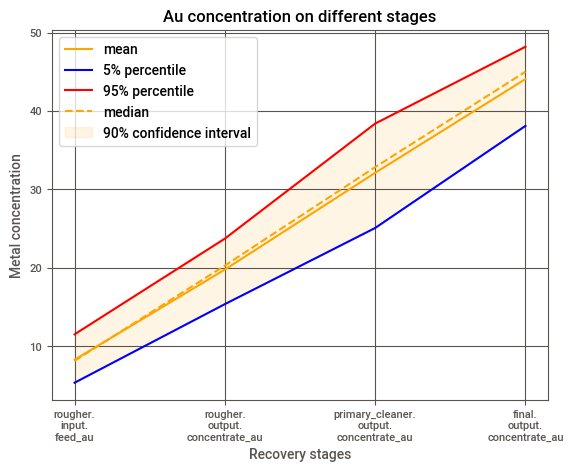

In [61]:
metal_concentration_graph(
    "Au concentration on different stages",
    source_data,
    ["feed_au", "concentrate_au"],
    [2, 3, 1, 0],
)

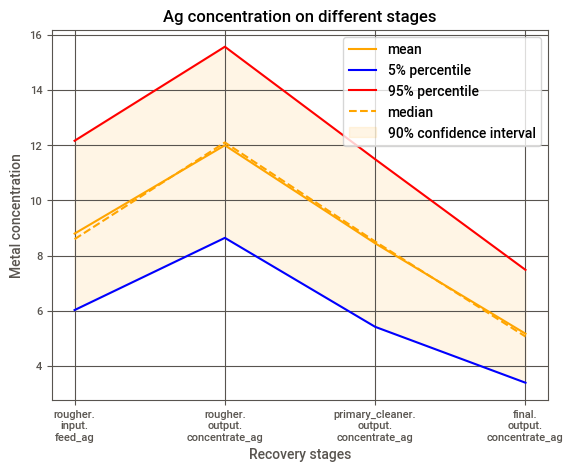

In [62]:
metal_concentration_graph(
    "Ag concentration on different stages",
    source_data,
    ["feed_ag", "concentrate_ag"],
    [2, 3, 1, 0],
)

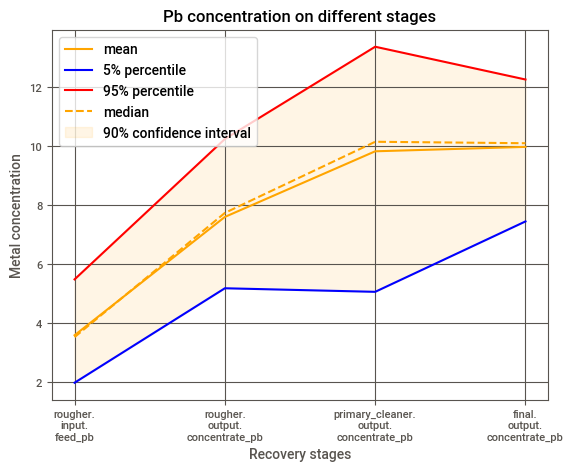

In [63]:
metal_concentration_graph(
    "Pb concentration on different stages",
    source_data,
    ["feed_pb", "concentrate_pb"],
    [2, 3, 1, 0],
)

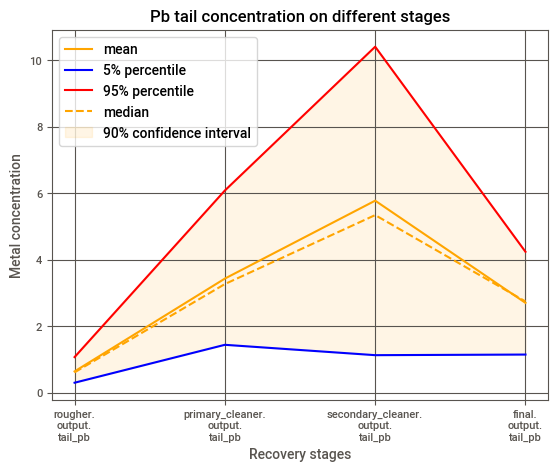

In [64]:
metal_concentration_graph(
    "Pb tail concentration on different stages", source_data, ["tail_pb"], [2, 1, 3, 0]
)

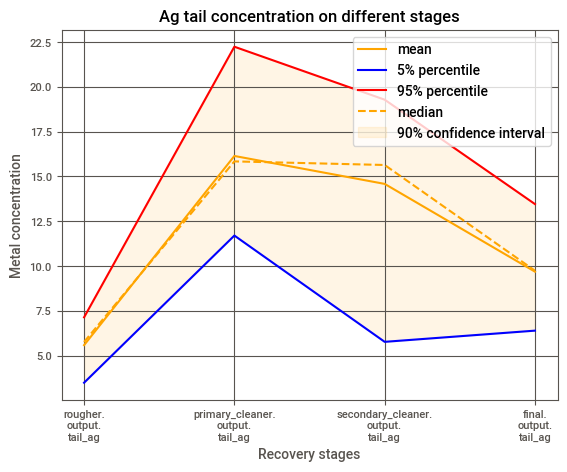

In [65]:
metal_concentration_graph(
    "Ag tail concentration on different stages", source_data, ["tail_ag"], [2, 1, 3, 0]
)

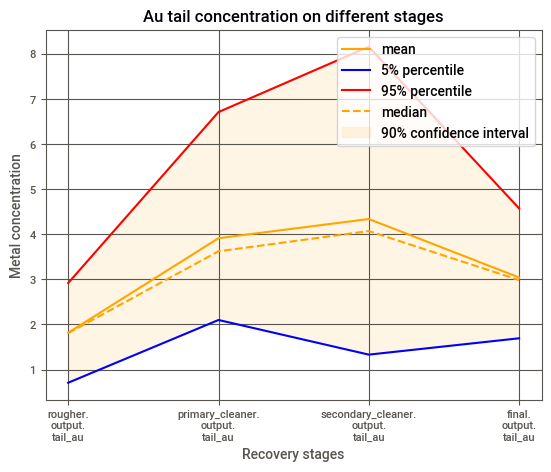

In [66]:
metal_concentration_graph(
    "Au tail concentration on different stages", source_data, ["tail_au"], [2, 1, 3, 0]
)

<b>Вывод: </b> Доля золота, ожидаемо, постоянно растет по мере движения по этапам техпроцесса. Доля свинца в концентрате также растет, но рост этот затухающий. Процентное содержание серебра в концентрате вырастает после этапа флотации, но потом на этапах очистки снижается до величины почти в 2 раза меньшей чем до начала обработки руды.  Доля же всех металлов в отвальных хвостах имеет схожую динамику - она растет до этапов очистки а после них начинает снижаться.

### 1.2.2. Распределение гранул сырья

Сравним распределения размеров гранул сырья на обучающей и тестовой выборках:

In [67]:
def feed_size_comparision(data_collection_param):
    for stage in ["rougher.input", "primary_cleaner.input"]:
        print(f"****** Feed size on {stage} train/test comparision: ******")
        fig, ax = plt.subplots()
        plt.title(f"Feed size on {stage} - density histgoram for train/test data")

        for key, dataframe in data_collection_param.items():
            data = dataframe[stage + ".feed_size"]

            print(f"----{key}-----")

            print("Mean feed size:", human_format(data.mean()))
            print(
                "90% confidence interval:",
                (
                    human_format(data.quantile(0.05)),
                    human_format(data.quantile(0.95)),
                ),
            )
            print(data.describe())
            print()

            data.hist(
                density=True, ax=ax, bins=150, label=key, alpha=0.5, edgecolor="gray"
            )

        ax.set_ylabel("Frequency density")
        ax.set_xlabel("Feed size")
        ax.legend()
        plt.show()

****** Feed size on rougher.input train/test comparision: ******
----Train Data-----
Mean feed size: 60.1
90% confidence interval: ('42.4', '85')
count    14005.000000
mean        60.110518
std         22.418485
min          9.659576
25%         48.973027
50%         55.373885
75%         66.080172
max        484.967466
Name: rougher.input.feed_size, dtype: float64

----Test Data-----
Mean feed size: 56
90% confidence interval: ('41.2', '85.7')
count    5289.000000
mean       55.951097
std        19.081758
min         0.046369
25%        43.906347
50%        50.841029
75%        62.431047
max       392.494040
Name: rougher.input.feed_size, dtype: float64



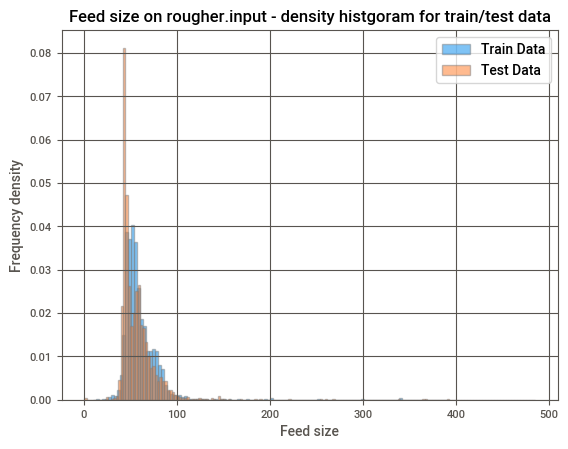

****** Feed size on primary_cleaner.input train/test comparision: ******
----Train Data-----
Mean feed size: 7.32
90% confidence interval: ('6.41', '8.38')
count    14149.000000
mean         7.322310
std          0.614062
min          1.080000
25%          6.960000
50%          7.290000
75%          7.700000
max         10.470000
Name: primary_cleaner.input.feed_size, dtype: float64

----Test Data-----
Mean feed size: 7.27
90% confidence interval: ('6.3', '8.27')
count    5290.000000
mean        7.266339
std         0.610219
min         5.650000
25%         6.890000
50%         7.250000
75%         7.600000
max        15.500000
Name: primary_cleaner.input.feed_size, dtype: float64



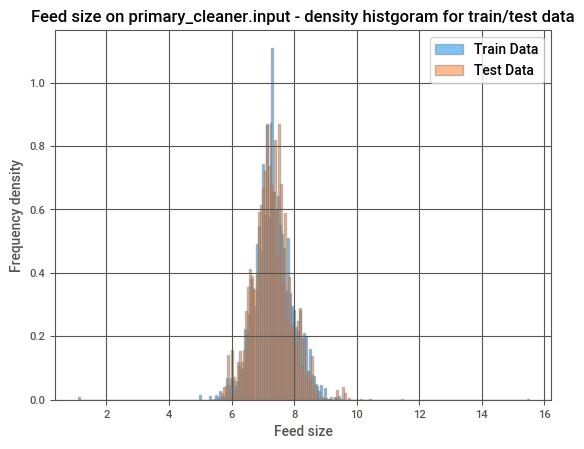

In [68]:
feed_size_comparision({"Train Data": train_data, "Test Data": test_data})

Видим, что отличия в распределениях есть: плотность распределения размера гранул сырья на входе во флотационную установку (`rougher.input.feed_size`) для выборок имеет схожий сдвиг вправо, но основные характеристики (mean/meadian/std) имеют отличия порядка 10% от величины.На входе у этапа первичной очистки размеры гранул\ уже имеют схожую плотность и характеристики распределения. Посмотрим, что будет если мы самостоятельно выделим тестовую выборку из данных:

****** Feed size on rougher.input train/test comparision: ******
----Train Data - alternative-----
Mean feed size: 59.1
90% confidence interval: ('41.9', '85.5')
count    14045.000000
mean        59.078741
std         21.938184
min          0.054843
25%         47.390560
50%         54.736503
75%         65.257684
max        484.967466
Name: rougher.input.feed_size, dtype: float64

----Test Data - alternative-----
Mean feed size: 58.7
90% confidence interval: ('41.8', '84.2')
count    5249.000000
mean       58.680177
std        20.799306
min         0.046369
25%        47.497514
50%        54.341490
75%        64.453573
max       368.882534
Name: rougher.input.feed_size, dtype: float64



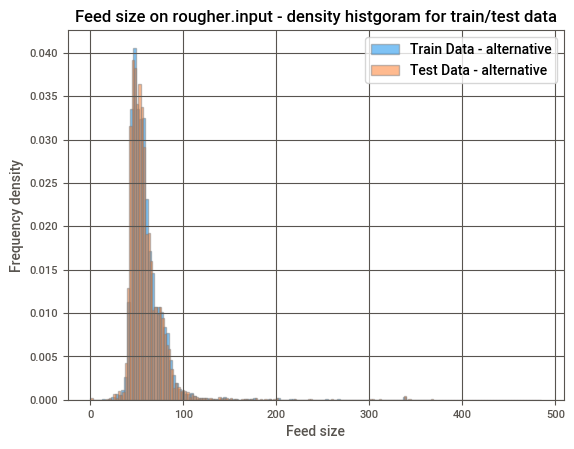

****** Feed size on primary_cleaner.input train/test comparision: ******
----Train Data - alternative-----
Mean feed size: 7.3
90% confidence interval: ('6.37', '8.32')
count    14149.000000
mean         7.300605
std          0.615195
min          1.080000
25%          6.940000
50%          7.280000
75%          7.660000
max         15.500000
Name: primary_cleaner.input.feed_size, dtype: float64

----Test Data - alternative-----
Mean feed size: 7.32
90% confidence interval: ('6.41', '8.38')
count    5290.000000
mean        7.324392
std         0.608696
min         1.080000
25%         6.950000
50%         7.300000
75%         7.690000
max         9.770000
Name: primary_cleaner.input.feed_size, dtype: float64



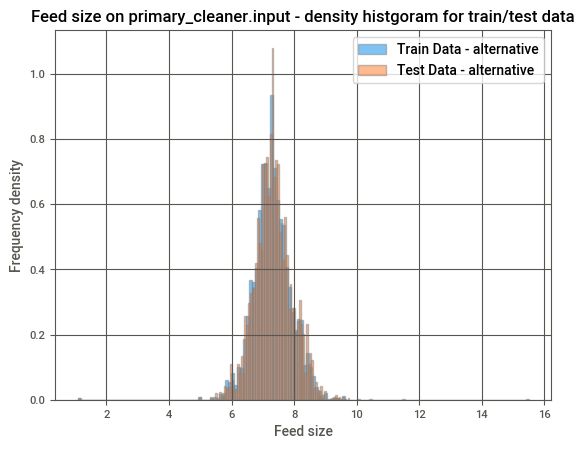

In [69]:
train_data_alternative, test_data_alternative = train_test_split(
    source_data, test_size=test_data.shape[0], random_state=14_11_22
)
feed_size_comparision(
    {
        "Train Data - alternative": train_data_alternative,
        "Test Data - alternative": test_data_alternative,
        # "All Data": source_data,
    }
)

Получается, что при самостоятельном выделении тестовой выборки характеристики распределения размеров гранул не имеют таких отличий, которые мы наблюдаем для предзаданной тестовой выборки.

<b>Вывод: </b> Данные для теста выбраны не очень удачно, распределение гранул сырья имеет отличия от распределения обучающего датасета. Возможно эти различия не настолько серьезные (~10%), но на тестовых данных выбраных самостоятельно качество работы модели скорее всего было бы выше.

### 1.2.3. Концентрация веществ на разных стадиях

Отфильтруем колонки харакетризующие концентрации веществ:

In [70]:
# filtering dataframe columns
ordered_columns = [
    col
    for col in source_data.columns
    if col.split(".")[-1:][0]
    in [
        "feed_pb",
        "concentrate_pb",
        "feed_ag",
        "concentrate_ag",
        "feed_au",
        "concentrate_au",
        "feed_sol",
        "concentrate_sol",
    ]
]
ordered_columns

['final.output.concentrate_ag',
 'final.output.concentrate_pb',
 'final.output.concentrate_sol',
 'final.output.concentrate_au',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_sol',
 'primary_cleaner.output.concentrate_au',
 'rougher.input.feed_ag',
 'rougher.input.feed_pb',
 'rougher.input.feed_sol',
 'rougher.input.feed_au',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_sol',
 'rougher.output.concentrate_au']

Посмотрим на гистограммы сумм долей веществ на разных этапах:

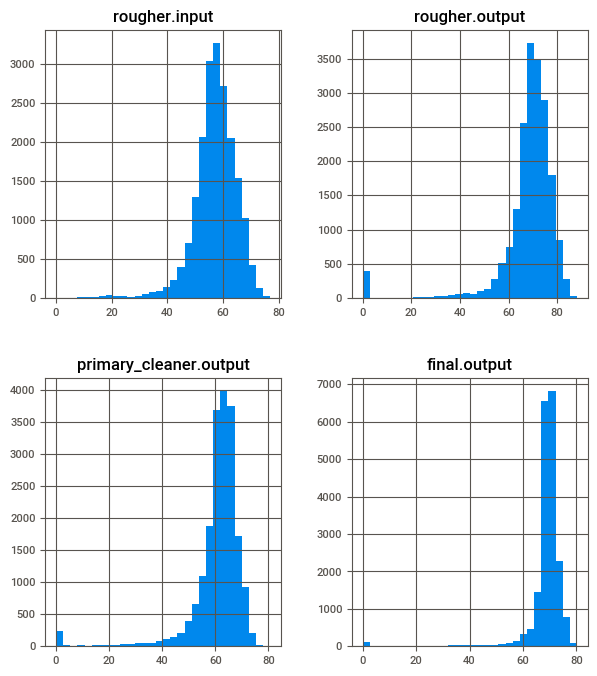

In [71]:
substance_frac = pd.DataFrame(source_data[ordered_columns])
substance_frac = substance_frac.transpose()

substance_frac["substance"] = substance_frac.index
substance_frac
substance_frac["stage"] = [
    ".".join(name[:-1]) for name in substance_frac["substance"].str.split(".").values
]
substance_frac["substance"] = [
    name[-1] for name in substance_frac["substance"].str.split("_").values
]

substance_frac["substance"]
substance_frac["stage"] = pd.Categorical(
    substance_frac["stage"],
    [
        "rougher.input",
        "rougher.output",
        "primary_cleaner.output",
        # "secondary_cleaner.output",
        "final.output",
    ],
)
substance_frac
grouped_substance_frac = substance_frac.groupby(["stage", "substance"]).mean()

# grouped_substance_frac.groupby(level=df2.index.names.difference(["stage"]))
_, ax = plt.subplots(2, 2, figsize=(7, 8))
grouped_substance_frac.groupby(
    level=grouped_substance_frac.index.names.difference(["substance"])
).sum().transpose().hist(ax=ax, bins=30)
plt.show()

Видим нулевые суммы долей веществ, особенно большое их число на выходе у флотационной установки и первичного очистителя.

In [72]:
with pd.option_context(
    "display.max_rows",
    None,
    "display.max_columns",
    None,
):
    display(
        source_data[
            source_data[
                [
                    "rougher.output.concentrate_ag",
                    "rougher.output.concentrate_pb",
                    "rougher.output.concentrate_sol",
                    "rougher.output.concentrate_au",
                ]
            ].sum(axis=1)
            == 0
        ].head(10)
    )

,date,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.output.concentrate_ag,primary_cleaner.output.concentrate_pb,primary_cleaner.output.concentrate_sol,primary_cleaner.output.concentrate_au,primary_cleaner.output.tail_ag,primary_cleaner.output.tail_pb,primary_cleaner.output.tail_sol,primary_cleaner.output.tail_au,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.calculation.sulfate_to_au_concentrate,rougher.calculation.floatbank10_sulfate_to_au_feed,rougher.calculation.floatbank11_sulfate_to_au_feed,rougher.calculation.au_pb_ratio,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.concentrate_au,rougher.output.recovery,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,rougher.output.tail_au,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.output.tail_ag,secondary_cleaner.output.tail_pb,secondary_cleaner.output.tail_sol,secondary_cleaner.output.tail_au,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level,date_weekday,date_monthday,date_yearday,date_hour
45,2016-01-16 21:00:00,4.566664,10.406178,4.588698,46.614456,68.403877,10.705777,1.509070,17.875134,2.509776,131.251366,13.969457,7.250000,1.203034,8.513177,9.724797,19.120964,37.633572,16.455383,3.366501,6.864404,3.434734,1601.674776,-500.285160,1600.151967,-499.633542,1599.542959,-499.495721,1599.342687,-500.360306,41359.061159,3196.130244,3205.717062,2.530283,7.521974,2.811569,581.605260,65.620714,41.154430,7.114065,13.322740,7.504592,13.311361,7.493738,0.0,0.0,0.0,0.0,0.0,4.784398,0.818965,20.046797,1.939811,999.026619,-499.850895,1600.614880,-500.331775,1598.654561,-500.364377,1398.394100,-501.540155,1197.182011,-500.205806,1198.542180,-499.648335,13.605154,4.983564,9.545239,3.102137,25.963860,-498.097243,23.896954,-500.047419,24.963926,-500.207267,23.984937,-500.613261,14.025588,-550.404242,12.028925,-550.570104,10.052072,-500.797905,7.984500,-499.581046,11.982025,-599.161228,5,16,16,21
46,2016-01-16 22:00:00,4.577832,10.691605,5.274175,46.250638,70.675633,10.728531,1.641216,18.349339,2.540843,141.184

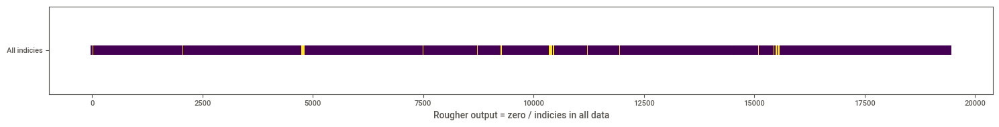

In [73]:
y = (
    (
        source_data[
            [
                "rougher.output.concentrate_ag",
                "rougher.output.concentrate_pb",
                "rougher.output.concentrate_sol",
                "rougher.output.concentrate_au",
            ]
        ].sum(axis=1)
        == 0
    ).astype(int),
)
fig, ax = plt.subplots(figsize=(15, 2))
cmap_cv = plt.cm.coolwarm
ax.scatter(
    source_data.index,
    [0.5] * len(source_data.index),
    c=y,
    marker="_",
    lw=10,
    # cmap=cmap_cv,
)
ax.set(
    # ylim=[0.4, 0.75],
    yticks=[0.5],
    yticklabels=["All indicies"],
    xlabel="Rougher output = zero / indicies in all data",
)

plt.tight_layout()
plt.show()
# source_data.date.isin(test_data.date).astype(int)

По индексам видим, что нулевые суммарные концентрации веществ на стадиях возникают на протяжении некоего временного промежутка - это может быть простой флотационной установки/очистителя, например, из-за обслуживания/неисправности. Удалять эти данные не будем, так как модель тоже должна уметь эти нулевые значения обрабатывать (например, заменять их). Визуально сравнив значения (в строках с нулевыми суммами) с боксплотами из пункта 1.5. каких-то аномалий в других признаках, харакетеризующих эти строки, обнаружить не удалось. Возможно какие-то закономерности удастся выявить модели.

Построим areaplot для средних от концентраций всех веществ:

In [74]:
mean_substance_frac = pd.DataFrame(source_data[ordered_columns].mean())

mean_substance_frac.index
mean_substance_frac["substance"] = mean_substance_frac.index
mean_substance_frac["stage"] = [
    ".".join(name[:-1])
    for name in mean_substance_frac["substance"].str.split(".").values
]
mean_substance_frac["substance"] = [
    name[-1] for name in mean_substance_frac["substance"].str.split("_").values
]
mean_substance_frac = mean_substance_frac.rename(columns={0: "mean"})

In [75]:
mean_substance_frac["stage"] = pd.Categorical(
    mean_substance_frac["stage"],
    [
        "rougher.input",
        "rougher.output",
        "primary_cleaner.output",
        "secondary_cleaner.output",
        "final.output",
    ],
)

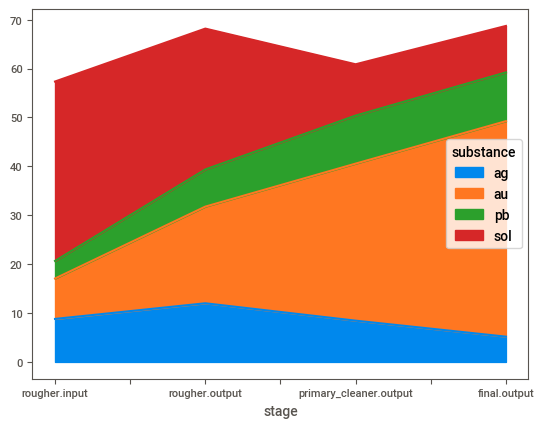

substance,ag,au,pb,sol
stage,,,,
rougher.input,8.794927,8.266097,3.598085,36.695114
rougher.output,11.994759,19.772000,7.606272,28.805571
primary_cleaner.output,8.442408,32.119400,9.829530,10.489499
final.output,5.168470,44.076513,9.978895,9.501224


In [76]:
# mean_substance_frac_t =
mean_substance_frac_pivot = mean_substance_frac.pivot(
    index="stage", columns="substance"
)["mean"].sort_values(by="stage")
ax = mean_substance_frac_pivot.plot.area()
plt.show()
mean_substance_frac_pivot

<b>Вывод: </b> Мы обнаружили нулевые суммы долей веществ, особенно большое их число на выходе у флотационной установки и первичного очистителя. Удалять эти данные не будем, так как модель тоже должна уметь эти нулевые значения обрабатывать

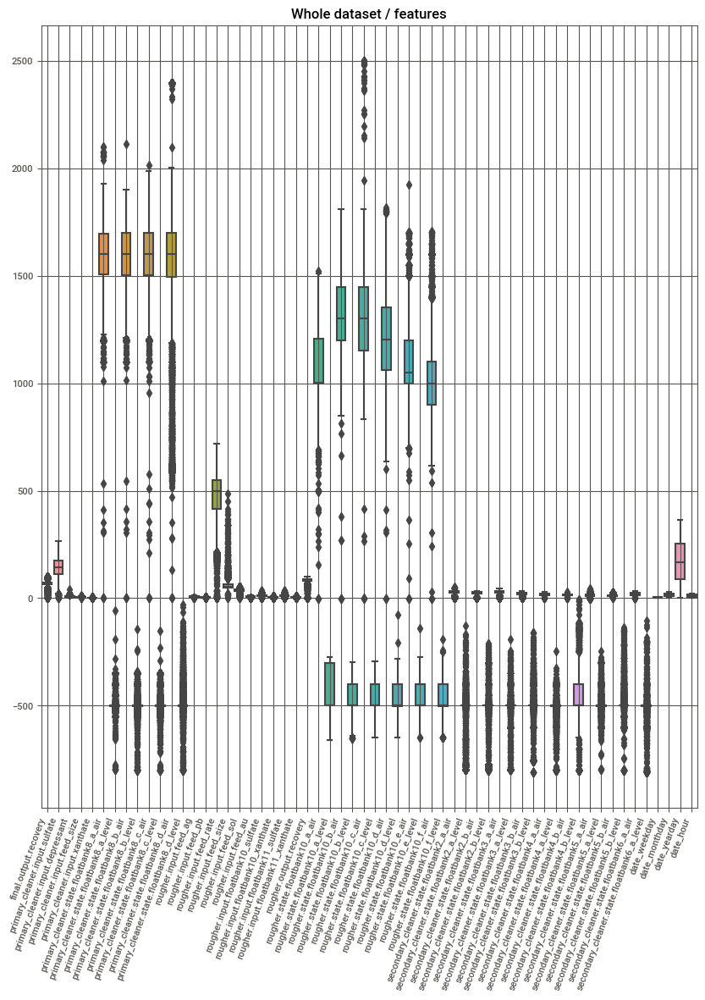

In [77]:
features_boxplot(source_data[input_state_cols_and_target], "Whole dataset / features")

In [78]:
zero_sum_filter = (
    train_data[
        [
            "rougher.output.concentrate_ag",
            "rougher.output.concentrate_pb",
            "rougher.output.concentrate_sol",
            "rougher.output.concentrate_au",
        ]
    ].sum(axis=1)
    == 0
)
with pd.option_context(
    "display.max_columns",
    None,
):
    index_to_remove = train_data[zero_sum_filter].index
    display(train_data[zero_sum_filter])

,date,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.output.concentrate_ag,primary_cleaner.output.concentrate_pb,primary_cleaner.output.concentrate_sol,primary_cleaner.output.concentrate_au,primary_cleaner.output.tail_ag,primary_cleaner.output.tail_pb,primary_cleaner.output.tail_sol,primary_cleaner.output.tail_au,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.calculation.sulfate_to_au_concentrate,rougher.calculation.floatbank10_sulfate_to_au_feed,rougher.calculation.floatbank11_sulfate_to_au_feed,rougher.calculation.au_pb_ratio,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.concentrate_au,rougher.output.recovery,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,rougher.output.tail_au,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.output.tail_ag,secondary_cleaner.output.tail_pb,secondary_cleaner.output.tail_sol,secondary_cleaner.output.tail_au,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level,date_weekday,date_monthday,date_yearday,date_hour
45,2016-01-16 21:00:00,4.566664,10.406178,4.588698,46.614456,68.403877,10.705777,1.509070,17.875134,2.509776,131.251366,13.969457,7.25,1.203034,8.513177,9.724797,19.120964,37.633572,16.455383,3.366501,6.864404,3.434734,1601.674776,-500.285160,1600.151967,-499.633542,1599.542959,-499.495721,1599.342687,-500.360306,41359.061159,3196.130244,3205.717062,2.530283,7.521974,2.811569,581.605260,65.620714,41.154430,7.114065,13.322740,7.504592,13.311361,7.493738,0.0,0.0,0.0,0.0,0.0,4.784398,0.818965,20.046797,1.939811,999.026619,-499.850895,1600.614880,-500.331775,1598.654561,-500.364377,1398.394100,-501.540155,1197.182011,-500.205806,1198.542180,-499.648335,13.605154,4.983564,9.545239,3.102137,25.963860,-498.097243,23.896954,-500.047419,24.963926,-500.207267,23.984937,-500.613261,14.025588,-550.404242,12.028925,-550.570104,10.052072,-500.797905,7.984500,-499.581046,11.982025,-599.161228,5,16,16,21
46,2016-01-16 22:00:00,4.577832,10.691605,5.274175,46.250638,70.675633,10.728531,1.641216,18.349339,2.540843,141.184039,

In [79]:
train_data = train_data.drop(index_to_remove, axis=0)

In [80]:
zero_sum_tail_filter = (
    train_data[
        [
            "secondary_cleaner.output.tail_ag",
            "secondary_cleaner.output.tail_pb",
            "secondary_cleaner.output.tail_sol",
            "secondary_cleaner.output.tail_au",
        ]
    ].sum(axis=1)
    == 0
)
with pd.option_context(
    "display.max_columns",
    None,
):
    index_to_remove_zero_tail = train_data[zero_sum_tail_filter].index
    display(train_data[zero_sum_tail_filter])

,date,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.output.concentrate_ag,primary_cleaner.output.concentrate_pb,primary_cleaner.output.concentrate_sol,primary_cleaner.output.concentrate_au,primary_cleaner.output.tail_ag,primary_cleaner.output.tail_pb,primary_cleaner.output.tail_sol,primary_cleaner.output.tail_au,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,primary_cleaner.state.floatbank8_c_level,primary_cleaner.state.floatbank8_d_air,primary_cleaner.state.floatbank8_d_level,rougher.calculation.sulfate_to_au_concentrate,rougher.calculation.floatbank10_sulfate_to_au_feed,rougher.calculation.floatbank11_sulfate_to_au_feed,rougher.calculation.au_pb_ratio,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,rougher.output.concentrate_ag,rougher.output.concentrate_pb,rougher.output.concentrate_sol,rougher.output.concentrate_au,rougher.output.recovery,rougher.output.tail_ag,rougher.output.tail_pb,rougher.output.tail_sol,rougher.output.tail_au,rougher.state.floatbank10_a_air,rougher.state.floatbank10_a_level,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level,secondary_cleaner.output.tail_ag,secondary_cleaner.output.tail_pb,secondary_cleaner.output.tail_sol,secondary_cleaner.output.tail_au,secondary_cleaner.state.floatbank2_a_air,secondary_cleaner.state.floatbank2_a_level,secondary_cleaner.state.floatbank2_b_air,secondary_cleaner.state.floatbank2_b_level,secondary_cleaner.state.floatbank3_a_air,secondary_cleaner.state.floatbank3_a_level,secondary_cleaner.state.floatbank3_b_air,secondary_cleaner.state.floatbank3_b_level,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level,date_weekday,date_monthday,date_yearday,date_hour
74,2016-01-18 04:00:00,4.821388,10.235502,1.581066,43.264258,84.687443,5.520487,0.821232,9.264695,1.263480,161.743280,11.978393,7.25,1.097857,0.000000,0.000000,0.000000,0.000000,5.594745,1.082635,2.845393,0.860176,1602.680809,-500.738258,1599.760900,-499.950057,1599.230418,-500.047977,1600.362308,-500.309124,45133.164569,3200.553753,3200.226096,2.677176,7.844640,2.653501,616.710761,65.729426,38.767396,7.103887,14.723131,7.501458,14.734324,7.500098,10.585663,7.076596,24.024872,18.614079,76.149160,5.775301,0.911031,20.490200,2.388462,1002.325843,-499.666257,1600.173133,-499.877318,1600.309331,-499.786564,1404.035000,-503.002881,1198.539117,-501.238642,1199.078049,-500.773546,0.0,0.0,0.0,0.0,28.044630,-499.065039,25.933710,-508.465372,24.983136,-509.506437,24.005055,-503.492963,14.016798,-548.935696,12.029818,-550.966916,10.012719,-501.020322,8.020406,-500.395112,11.995851,-598.774893,0,18,18,4
75,2016-01-18 05:00:00,4.392827,10.611895,3.769994,46.543285,100.000000,0.000000,0.000000,0.000000,0.000000,157.53238

In [81]:
train_data = train_data.drop(index_to_remove_zero_tail, axis=0)

## 1.3. Модель

### 1.3.1. Метрика качества sMAPE

Для решения задачи введём новую метрику качества — sMAPE (англ. Symmetric Mean Absolute Percentage Error, «симметричное среднее абсолютное процентное отклонение».

$$
\text { sMAPE }=\frac{1}{N} \sum_{i=1}^N \frac{\left|\mathbf{y}_i-\hat{\mathbf{y}}_i\right|}{\left(\left|\mathbf{y}_i\right|+\left|\hat{\mathbf{y}}_{\mathbf{i}}\right|\right) / 2} \times 100 \%
$$

In [82]:
def smape(y_true, y_pred):
    return (
        (1 / len(y_true))
        * ((abs(y_true - y_pred)) / ((y_true.abs() + abs(y_pred)) / 2)).sum()
        * 100
    )

In [83]:
def error_sape(y_true, y_pred):
    return (
        (1 / len(y_true))
        * ((abs(y_true - y_pred)) / ((y_true.abs() + abs(y_pred)) / 2))
        * 100
    )

In [84]:
smape_score = make_scorer(smape, greater_is_better=False)

In [85]:
# aux function to write different data as collection to array to be converted to DataFrame;
def add_model_record(results_array, **kwargs):
    results_array.append(kwargs)

### 1.3.2. Pipeline

#### 1.3.2.1. Кастомные классы и функции

Напишем новый класс для применения функции к датафрейму - чтобы извлечь из date признака части даты:

In [86]:
class DataframeFunctionTransformer:
    def __init__(self, func, **kwargs):
        self.func = func
        self.args = kwargs

    def transform(self, input_df, **transform_params):
        return self.func(input_df, **self.args)

    def fit(self, X, y=None, **fit_params):
        return self

Сама функция для извлечения из date-признака частей даты:

In [87]:
def add_date_parts(dataframe):
    df = dataframe.copy()
    date = pd.to_datetime(df["date"])
    df.loc[:, "date_weekday"] = date.dt.weekday
    df.loc[:, "date_monthday"] = date.dt.day
    df.loc[:, "date_yearday"] = date.dt.dayofyear
    df.loc[:, "date_hour"] = date.dt.hour
    return df

In [88]:
def add_zscore(
    arr,
    add_has_outliers=True,
    add_count_of_outliers=True,
    add_abs_mean_z_score=True,
    add_mean_z_score=True,
):
    if add_has_outliers:
        arr = np.column_stack(
            (
                arr,
                (abs(zscore(arr, nan_policy="omit")) > 3).sum(axis=1) > 0,
            )
        )
    if add_count_of_outliers:
        arr = np.column_stack(
            (
                arr,
                (abs(zscore(arr, nan_policy="omit")) > 3).sum(axis=1),
            )
        )
    if add_abs_mean_z_score:
        arr = np.column_stack(
            (
                arr,
                np.nanmean(abs(zscore(arr, nan_policy="omit")), axis=1),
            )
        )
    if add_mean_z_score:
        arr = np.column_stack(
            (
                arr,
                np.nanmean(zscore(arr, nan_policy="omit"), axis=1),
            )
        )
    return arr

In [89]:
def add_nan_indicator(arr):
    return np.column_stack((arr, np.isnan(arr).sum(axis=1)))

In [90]:
class ClfSwitcher(BaseEstimator):
    def __init__(
        self,
        estimator=RandomForestRegressor(),
    ):
        """
        A Custom BaseEstimator that can switch between classifiers.
        :param estimator: sklearn object - The classifier
        """

        self.estimator = estimator

    def fit(self, X, y=None, **kwargs):
        self.estimator.fit(X, y)
        return self

    def predict(self, X, y=None):
        return self.estimator.predict(X)

    # @available_if(self.is_classifier(estimator))
    def predict_proba(self, X):
        return self.estimator.predict_proba(X)

    def score(self, X, y):
        return self.estimator.score(X, y)

In [91]:
class Debug(BaseEstimator, TransformerMixin):
    def transform(self, X):

        self.shape = X.shape

        print(self.shape)
        self.copy_of_X = X.copy()
        print(X[:10])  # TODO: check 10 is not less than len
        return X

    def fit(self, X, y=None, **fit_params):
        return self

#### 1.3.2.2. Сборка пайплайна

Сделаем пайплайны для обработки признаков:
* date_pipe - добавление дней/часов
* num_pipe - замена пропусков c помощью imputer и масштабирование с помощью scaler
* transformer - для обработки числовых признаков, причем с помощью make_column_selector числовые определяются динамически (чтобы учесть date_ признаки)

In [92]:
# date feature pipeline
date_pipe = Pipeline(
    [
        (
            "add_date_parts",
            DataframeFunctionTransformer(add_date_parts),
        )
    ]
)

# numeric features pipeline
num_pipe = Pipeline(
    [
        (
            "add_nan_indicator",
            DataframeFunctionTransformer(add_nan_indicator),
        ),
        # ("dbg1", Debug()),
        (
            "add_zscore",
            DataframeFunctionTransformer(add_zscore),
        ),
        # ("dbg2", Debug()),
        ("imputer", KNNImputer(n_neighbors=5, weights="uniform")),
        # (
        #     "zero_imputer",
        #     KNNImputer(n_neighbors=5, weights="uniform", missing_values=0),
        # ),
        # ("dbg3", Debug()),
        ("scaler", PowerTransformer()),
        # ("dbg4", Debug()),
    ]
)

# applying num_pipe to dynamically selecting numeric types
transformer = ColumnTransformer(
    transformers=[("num", num_pipe, make_column_selector(dtype_include=np.number))],
    remainder="drop",
    n_jobs=-1,
)

In [93]:
pipeline = Pipeline(
    [
        ("date_pipe", date_pipe),
        # ("dbg0", Debug()),
        ("transformer", transformer),
        # ("dbg3", Debug()),
        ("clf", ClfSwitcher()),
    ]
)

pipeline.get_params()

#### 1.3.2.3. Перебираемые гиперпараметры

In [94]:
parameters = [
    {
        "clf__estimator": [GradientBoostingRegressor(random_state=14_11_22)],
        "clf__estimator__n_estimators": list(range(44, 47, 1)),
        "clf__estimator__max_depth": list(range(2, 5)),
        "clf__estimator__loss": ["squared_error", "huber"],
        # "clf__estimator__criterion": ["mse", "friedman_mse"],
        "clf__estimator__max_features": ["sqrt", "log2"],
        "transformer__num__imputer": [
            KNNImputer(),
            # SimpleImputer(),
            # None
        ],
        "transformer__num__scaler": [
            PowerTransformer(),
            # RobustScaler(),
            # StandardScaler(),
            # None,
        ],
        "transformer__num__add_zscore": [
            None,
          
            DataframeFunctionTransformer(
                add_zscore,
                add_has_outliers=True,
                add_count_of_outliers=False,
                add_abs_mean_z_score=False,
                add_mean_z_score=False,
            ),
        ],
        "transformer__num__add_nan_indicator": [
            None,
            DataframeFunctionTransformer(add_nan_indicator),
        ]
    },
]

In [95]:
parameters_rougher = [
   
    {
        "clf__estimator": [GradientBoostingRegressor(random_state=14_11_22)],
        "clf__estimator__n_estimators": list(range(44, 47, 1)),
        "clf__estimator__max_depth": list(range(2, 5)),
        "clf__estimator__loss": ["lad", "huber"],
        # "clf__estimator__criterion": ["mse", "friedman_mse"],
        "clf__estimator__max_features": ["sqrt", "log2"],
        "transformer__num__imputer": [
            KNNImputer(),
            # SimpleImputer(),
            # None
        ],
        "transformer__num__scaler": [
            PowerTransformer(),
            # RobustScaler(),
            # StandardScaler(),
            # None,
        ],
        "transformer__num__add_zscore": [
            None,
            
            DataframeFunctionTransformer(
                add_zscore,
                add_has_outliers=True,
                add_count_of_outliers=False,
                add_abs_mean_z_score=False,
                add_mean_z_score=False,
            ),
          
        ],
        "transformer__num__add_nan_indicator": [
            None,
            DataframeFunctionTransformer(add_nan_indicator),
        ]
        
    },
]

### 1.3.3. Прогнозирование эффективности обогащения (флотации)

Построим модель для предсказывания Rougher.output.recovery на основе параметров золотосодержащей руды (rougher.input.\*) и параметров, характеризующих текущее состояние флотационной установки (rougher.state.\*) - именно они будут доступны в тестовой выборке и определяют содержание золота в концентрате/хвостах после флотации. Список всех признаков для X: 

In [96]:
rougher_input_state_cols_and_target

['date',
 'rougher.input.feed_ag',
 'rougher.input.feed_pb',
 'rougher.input.feed_rate',
 'rougher.input.feed_size',
 'rougher.input.feed_sol',
 'rougher.input.feed_au',
 'rougher.input.floatbank10_sulfate',
 'rougher.input.floatbank10_xanthate',
 'rougher.input.floatbank11_sulfate',
 'rougher.input.floatbank11_xanthate',
 'rougher.output.recovery',
 'rougher.state.floatbank10_a_air',
 'rougher.state.floatbank10_a_level',
 'rougher.state.floatbank10_b_air',
 'rougher.state.floatbank10_b_level',
 'rougher.state.floatbank10_c_air',
 'rougher.state.floatbank10_c_level',
 'rougher.state.floatbank10_d_air',
 'rougher.state.floatbank10_d_level',
 'rougher.state.floatbank10_e_air',
 'rougher.state.floatbank10_e_level',
 'rougher.state.floatbank10_f_air',
 'rougher.state.floatbank10_f_level',
 'date_weekday',
 'date_monthday',
 'date_yearday',
 'date_hour']

In [97]:
train_data_flotation = train_data[rougher_input_state_cols_and_target]


X = train_data_flotation.drop("rougher.output.recovery", axis=1)
y = train_data_flotation["rougher.output.recovery"]

In [98]:
rs_cv = RandomizedSearchCV(
    pipeline,
    n_iter=40,
    param_distributions=parameters_rougher,
    verbose=-1,
    scoring=smape_score,
    cv=10,
    n_jobs=-1,
    random_state=14_11_22,
)

In [99]:
with warnings.catch_warnings(record=True):
    warnings.simplefilter('ignore')
    rs_cv.fit(X, y)

In [100]:
print("Best estimator:")
rs_cv.best_estimator_

Best estimator:


Pipeline(steps=[('date_pipe',
                 Pipeline(steps=[('add_date_parts',
                                  <__main__.DataframeFunctionTransformer object at 0x7f39dc9d4490>)])),
                ('transformer',
                 ColumnTransformer(n_jobs=-1,
                                   transformers=[('num',
                                                  Pipeline(steps=[('add_nan_indicator',
                                                                   None),
                                                                  ('add_zscore',
                                                                   None),
                                                                  ('imputer',
                                                                   KNNImputer()),
                                                                  ('scaler',
                                                                   PowerTransformer())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7f39dc9d4c70>)])),
                ('clf',
                 ClfSwitcher(estimator=GradientBoostingRegressor(loss='huber',
                                                                 max_features='sqrt',
                                                                 n_estimators=46,
                                                                 random_state=141122)))])

In [101]:
rougher_input_state_cols_and_target_4_test = rougher_input_state_cols_and_target.copy()
rougher_input_state_cols_and_target_4_test=set(rougher_input_state_cols_and_target_4_test)-set(["rougher.output.recovery",'date_hour', 'date_yearday', 'date_monthday', 'date_weekday'])
y_pred = rs_cv.best_estimator_.predict(
    test_data[rougher_input_state_cols_and_target_4_test]
)
y_true = test_data_from_source["rougher.output.recovery"]

print("Predicted mean value for rougher.output.recovery:", y_pred.mean())
smape_rougher = smape(y_true, y_pred)
print("sMAPE value for rougher.output.recovery predictions:", smape_rougher)

Predicted mean value for rougher.output.recovery: 87.10703671365447
sMAPE value for rougher.output.recovery predictions: 7.478783604259487


#### 1.3.3.1. Feature importances

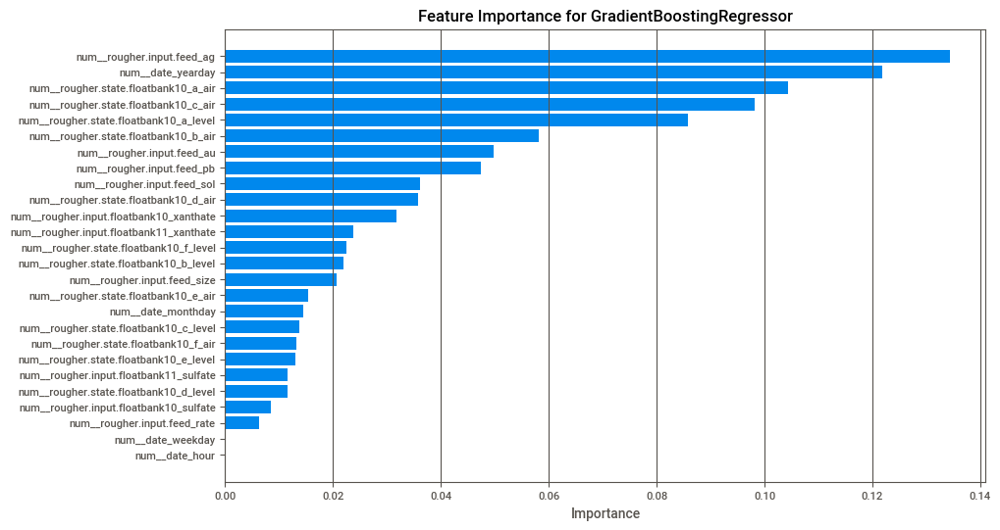

In [102]:
feature_importance = (
    rs_cv.best_estimator_.named_steps["clf"].estimator.feature_importances_
)
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(10, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align="center")
plt.yticks(
    range(len(sorted_idx)),
    np.array(
        rs_cv.best_estimator_.named_steps.transformer.get_feature_names_out()
    )[sorted_idx],
)
plt.grid(axis="x")
plt.title("Feature Importance for GradientBoostingRegressor")
plt.xlabel("Importance")
plt.show()

### 1.3.4. Прогнозирование финальной эффективности обогащения с очисткой

Построим модель для предсказывания final.output.recovery на основе:
* всех input-параметров (\*.input.\*) 
* параметров, характеризующих текущее состояние флотационной установки и очистителей (\*.state.\*)


Список всех признаков для X: 

In [103]:
test_data_original.columns.values

array(['date', 'primary_cleaner.input.sulfate',
       'primary_cleaner.input.depressant',
       'primary_cleaner.input.feed_size',
       'primary_cleaner.input.xanthate',
       'primary_cleaner.state.floatbank8_a_air',
       'primary_cleaner.state.floatbank8_a_level',
       'primary_cleaner.state.floatbank8_b_air',
       'primary_cleaner.state.floatbank8_b_level',
       'primary_cleaner.state.floatbank8_c_air',
       'primary_cleaner.state.floatbank8_c_level',
       'primary_cleaner.state.floatbank8_d_air',
       'primary_cleaner.state.floatbank8_d_level',
       'rougher.input.feed_ag', 'rougher.input.feed_pb',
       'rougher.input.feed_rate', 'rougher.input.feed_size',
       'rougher.input.feed_sol', 'rougher.input.feed_au',
       'rougher.input.floatbank10_sulfate',
       'rougher.input.floatbank10_xanthate',
       'rougher.input.floatbank11_sulfate',
       'rougher.input.floatbank11_xanthate',
       'rougher.state.floatbank10_a_air',
       'rougher.state.floatban

In [104]:
X = train_data[test_data_original.columns]
y = train_data["final.output.recovery"]

In [105]:
rs_cv_final = RandomizedSearchCV(
    pipeline,
    n_iter=100,
    param_distributions=parameters,
    verbose=True,
    scoring=smape_score,
    cv=10,
    n_jobs=-1,
    random_state=14_11_22,
)

In [106]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    rs_cv_final.fit(X, y)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


In [107]:
print("Best estimator:")
rs_cv_final.best_estimator_

Best estimator:


Pipeline(steps=[('date_pipe',
                 Pipeline(steps=[('add_date_parts',
                                  <__main__.DataframeFunctionTransformer object at 0x7f39dc8ca220>)])),
                ('transformer',
                 ColumnTransformer(n_jobs=-1,
                                   transformers=[('num',
                                                  Pipeline(steps=[('add_nan_indicator',
                                                                   None),
                                                                  ('add_zscore',
                                                                   <__main__.DataframeFunctionTransformer object at 0x7f39dc8cae20>),
                                                                  ('imputer',
                                                                   KNNImputer()),
                                                                  ('scaler',
                                                                   PowerTransformer())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7f39dc8ca940>)])),
                ('clf',
                 ClfSwitcher(estimator=GradientBoostingRegressor(loss='huber',
                                                                 max_depth=2,
                                                                 max_features='log2',
                                                                 n_estimators=45,
                                                                 random_state=141122)))])

In [109]:
y_pred = rs_cv_final.best_estimator_.predict(test_data)
y_true = test_data_from_source["final.output.recovery"]

smape_final = smape(y_true, y_pred)
print("Predicted mean value for final.output.recovery:", y_pred.mean())
print("sMAPE value for final.output.recovery predictions:", smape_final)

Predicted mean value for final.output.recovery: 68.50314538238706
sMAPE value for final.output.recovery predictions: 8.650241525655641


### 1.3.5. Итоговое sMAPE

$$
\text {Итоговое sMAPE } = 25 \% \times \text { sMAPE(rougher) }+75 \% \times \text { sMAPE(final) }
$$

In [111]:
smape_result = 0.25 * smape_rougher + 0.75 * smape_final
print("sMAPE combined result", smape_result)

sMAPE combined result 8.357377045306603


### 1.3.6. Проверка модели на адекватность

#### 1.3.6.1. Эффективность DummyRegressor для rougher

In [115]:
X = train_data_flotation.drop("rougher.output.recovery", axis=1)
y = train_data_flotation["rougher.output.recovery"]
dummy_regr = DummyRegressor(strategy="mean")
dummy_regr.fit(X, y)

DummyRegressor()

In [116]:
y_pred = dummy_regr.predict(test_data[rougher_input_state_cols_and_target_4_test])
y_true = test_data_from_source["rougher.output.recovery"]

print("Dummy predicted mean value for rougher.output.recovery:", y_pred.mean())
smape_rougher_dummy = smape(y_true, y_pred)
print(
    "Dummy sMAPE value for rougher.output.recovery predictions:",
    smape_rougher_dummy,
)

Dummy predicted mean value for rougher.output.recovery: 84.30694953547153
Dummy sMAPE value for rougher.output.recovery predictions: 9.19125067073498


#### 1.3.6.2. Эффективность DummyRegressor для финальной стадии

In [117]:
X = train_data[test_data_original.columns]
y = train_data["final.output.recovery"]
dummy_regr = DummyRegressor(strategy="mean")
dummy_regr.fit(X, y)

DummyRegressor()

In [118]:
y_pred = dummy_regr.predict(test_data)
y_true = test_data_from_source["final.output.recovery"]

smape_final_dummy = smape(y_true, y_pred)
print("Dummy predicted mean value for final.output.recovery:", y_pred.mean())
print("Dummy sMAPE value for final.output.recovery predictions:", smape_final_dummy)

Dummy predicted mean value for final.output.recovery: 66.4948074122493
Dummy sMAPE value for final.output.recovery predictions: 10.2745796590877


#### 1.3.6.3. Итоговое sMAPE для DummyRegressor

In [119]:
smape_result_dummy = 0.25 * smape_rougher_dummy + 0.75 * smape_final_dummy
print("Dummy sMAPE combined result", smape_result_dummy)

Dummy sMAPE combined result 10.00374741199952


Видим, что качеcтво обученной нами модели значительно выше, чем у DummyRegressor: sMAPE нашей модели на 1.72 процентных пункта меньше чем у dummy-модели.

## 1.4. Общий вывод

Выполняя предварительный анализ датасетов, мы обратили внимание на следующее:
* <b>не слишком удачный выбор индексов для тестовых данных</b> (недостаточно случайное распределение), что привело к видимой разнице в распределениях признаков:
  * В сравнительном отчете <b>для тестовой/обучающей выборок мы увидели много различий в распределениях признаков</b>. Например, в наиболее влияющем на значения recovery - сульфате на входе в первый очиститель (primary_cleaner.input.sulfate - pi.sulfate) увидели сильное смещение пиков test-гистограммы относительно train-гистограммы. Или, например, во влияющих на значения recovery для этапа флотации - концентрациях веществ на входе rougher.input.feed_ag, rougher.input.feed_pb, rougher.input.feed_au также видны смещения пиков test-гистограммы относительно train-гистограммы и, соответственно, отличия в целевых признаках.
  * Обнаружили также, что распределение гранул сырья в тестовой выборке имеет отличия от распределения обучающего датасета. Возможно эти различия не настолько серьезные

* На диаграммах размаха для признаков доступных в тестовой выборке мы видим, что <b>почти у всех признаков есть выбросы</b> - что может повлиять на качество работы нашей модели. Следует попробовать обработать выбросы с помощью специальных scaler-ов (PowerTransformer, например).

* Обнаружили строки с <b>пропусками и нулевыми суммами долей веществ</b> и далее обработали их моделью с помощью Imputer-ов. 

* Касательно <b>концентраций</b> различных веществ мы обратили внимание на следующее:
  * Доля золота, ожидаемо, постоянно растет по мере движения по этапам техпроцесса. 
  * Доля свинца в концентрате также растет, но рост этот затухающий. 
  * Процентное содержание серебра в концентрате вырастает после этапа флотации, но потом на этапах очистки снижается до величины почти в 2 раза меньшей чем до начала обработки руды.  
  * Доля же всех металлов в отвальных хвостах имеет схожую динамику - она растет до этапов очистки а после них начинает снижаться.

Были построены две похожие <b>модели для расчета recovery флотационного этапа и recovery всего техпроцесса с очисткой</b>:
* с помощью кастомного класса было реализовано извлечение дня года/месяца/недели, часа из признака date и добавление их в датафрейм для последующего использования в модели
* с помощью RandomizedSearchCV было реализовано следующее:
  * кросс-валидация на 10 фолдах
  * подбор imputer-ов
  * подбор scaler-ов
* с помощью кастомного класса и параметров для RandomizedSearchCV был реализован перебор трех моделей (RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor) и параметров к ним
* получили итоговое <b>sMAPE для тестовой выборки</b> ~ 8.35%